In [1]:
%load_ext autoreload

In [18]:
%autoreload 
import optuna
from lightgbm import LGBMRegressor
from optuna.integration import lightgbm as lgb

import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

import utilities as ut

In [3]:
# Read and structure all the parquet files in the data folder
data_list = ut.read_data()
# Create a data processor object
Data = ut.DataProcessor(data_list)
# Create the formatted dataframe
df = Data.create_train_data()
# slice df to only include from 2019-09-04 08:00:00 onwards (this is where we have data for all features)
df.sort_index(inplace=True)
df = df.loc['2019-09-04 08:00:00':]

In [4]:
FEATURES = list(df.columns)
FEATURES.remove('pv_measurement')

TARGET = 'pv_measurement'

X_train = df[FEATURES]
y_train = df[TARGET]

X_test = Data.create_test_data()
X_test = X_test[FEATURES]

In [5]:
# X_train_selected = X_train['direct_rad:W', 'building', 'sun_elevation:d', 'sun_azimuth:d', 'day_of_year', 'air_density_2m:kgm3', 'wind_speed_u_10:mms', 'msl_pressure:hPa', 'cloud_base_agl:m', 'ceiling_height_agl:m', 'visibility:m', 'relative_humidity_1000hPa:p', 'wind_speed_10m:ms', 'effective_cloud_cover:p', 'day_of_month', 'year', 'fresh_snow_24h:cm', 'fresh_snow_6h:cm', 'fresh_snow_1h:cm']
feats = ['direct_rad:W', 'elevation:m', 'sun_elevation:d', 'sun_azimuth:d', 'day_of_year', 'air_density_2m:kgm3', 'wind_speed_u_10m:ms', 'msl_pressure:hPa', 'cloud_base_agl:m', 'ceiling_height_agl:m', 'visibility:m', 'relative_humidity_1000hPa:p', 'wind_speed_10m:ms', 'effective_cloud_cover:p', 'day_of_month', 'year', 'fresh_snow_24h:cm', 'fresh_snow_6h:cm', 'fresh_snow_1h:cm', 'hour']
X_train_selected = X_train[feats]
X_test_selected = X_test[feats]

In [6]:
# I need to remove all special JSON characters from the column names
X_train_selected.columns = X_train_selected.columns.str.replace(':', '_')
X_test.columns = X_test.columns.str.replace(':', '_')

In [27]:
X_train_selected.shape

(84798, 20)

In [79]:
def objective(trial,data=X_train_selected,target=y_train):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.2,random_state=42)
    param = {
        'metric': 'mae', 
        'random_state': 48,
        'n_estimators': 20000,
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-3, 10.0, log=True),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 10.0, log=True),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
        'max_depth': trial.suggest_categorical('max_depth', [10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
    }
    model = LGBMRegressor(**param)  
    
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)])
    
    preds = model.predict(test_x)
    
    mae = mean_absolute_error(test_y, preds)

    return mae

In [80]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2023-10-08 11:42:43,698] A new study created in memory with name: no-name-8b301d89-9582-4fc7-9276-9134655471c3


[1]	valid_0's l1: 396.544
[2]	valid_0's l1: 389.16
[3]	valid_0's l1: 381.941
[4]	valid_0's l1: 374.895
[5]	valid_0's l1: 368.043
[6]	valid_0's l1: 361.343
[7]	valid_0's l1: 354.763
[8]	valid_0's l1: 348.365
[9]	valid_0's l1: 342.097
[10]	valid_0's l1: 335.978
[11]	valid_0's l1: 330.005
[12]	valid_0's l1: 325.765
[13]	valid_0's l1: 321.633
[14]	valid_0's l1: 315.983
[15]	valid_0's l1: 312.095
[16]	valid_0's l1: 306.664
[17]	valid_0's l1: 301.362
[18]	valid_0's l1: 296.21
[19]	valid_0's l1: 291.283
[20]	valid_0's l1: 286.42
[21]	valid_0's l1: 281.676
[22]	valid_0's l1: 277.078
[23]	valid_0's l1: 272.602
[24]	valid_0's l1: 268.27
[25]	valid_0's l1: 265.22
[26]	valid_0's l1: 262.316
[27]	valid_0's l1: 258.243
[28]	valid_0's l1: 254.265
[29]	valid_0's l1: 250.401
[30]	valid_0's l1: 246.706
[31]	valid_0's l1: 243.031
[32]	valid_0's l1: 239.496
[33]	valid_0's l1: 235.995
[34]	valid_0's l1: 233.611
[35]	valid_0's l1: 230.264
[36]	valid_0's l1: 227.016
[37]	valid_0's l1: 223.809
[38]	valid_0's 

[I 2023-10-08 11:48:04,205] Trial 0 finished with value: 100.73863753417952 and parameters: {'reg_alpha': 0.7197703238745896, 'reg_lambda': 2.6702777904176243, 'colsample_bytree': 0.9, 'subsample': 0.5, 'learning_rate': 0.02, 'max_depth': 100, 'num_leaves': 207, 'min_child_samples': 263, 'min_data_per_groups': 31}. Best is trial 0 with value: 100.73863753417952.


[1]	valid_0's l1: 399.868
[2]	valid_0's l1: 396.975
[3]	valid_0's l1: 396.108
[4]	valid_0's l1: 394.403
[5]	valid_0's l1: 392.851
[6]	valid_0's l1: 390.781
[7]	valid_0's l1: 388.699
[8]	valid_0's l1: 385.868
[9]	valid_0's l1: 383.969
[10]	valid_0's l1: 382.02
[11]	valid_0's l1: 381.698
[12]	valid_0's l1: 380.515
[13]	valid_0's l1: 378.548
[14]	valid_0's l1: 375.867
[15]	valid_0's l1: 374.06
[16]	valid_0's l1: 371.308
[17]	valid_0's l1: 370.766
[18]	valid_0's l1: 369.649
[19]	valid_0's l1: 368.958
[20]	valid_0's l1: 367.179
[21]	valid_0's l1: 364.564
[22]	valid_0's l1: 362.862
[23]	valid_0's l1: 361.192
[24]	valid_0's l1: 360.25
[25]	valid_0's l1: 359.336
[26]	valid_0's l1: 358.736
[27]	valid_0's l1: 357.088
[28]	valid_0's l1: 355.44
[29]	valid_0's l1: 354.817
[30]	valid_0's l1: 352.228
[31]	valid_0's l1: 350.71
[32]	valid_0's l1: 349.174
[33]	valid_0's l1: 347.656
[34]	valid_0's l1: 346.215
[35]	valid_0's l1: 345.978
[36]	valid_0's l1: 344.539
[37]	valid_0's l1: 343.072
[38]	valid_0's 

[I 2023-10-08 11:51:55,125] Trial 1 finished with value: 110.281459903853 and parameters: {'reg_alpha': 0.506015897990931, 'reg_lambda': 0.011682952625419966, 'colsample_bytree': 0.3, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 652, 'min_child_samples': 229, 'min_data_per_groups': 11}. Best is trial 0 with value: 100.73863753417952.


[1]	valid_0's l1: 399.823
[2]	valid_0's l1: 396.834
[3]	valid_0's l1: 393.87
[4]	valid_0's l1: 390.933
[5]	valid_0's l1: 388.027
[6]	valid_0's l1: 385.14
[7]	valid_0's l1: 382.29
[8]	valid_0's l1: 379.465
[9]	valid_0's l1: 376.658
[10]	valid_0's l1: 373.882
[11]	valid_0's l1: 371.135
[12]	valid_0's l1: 369.144
[13]	valid_0's l1: 367.181
[14]	valid_0's l1: 364.497
[15]	valid_0's l1: 362.587
[16]	valid_0's l1: 359.944
[17]	valid_0's l1: 357.321
[18]	valid_0's l1: 354.724
[19]	valid_0's l1: 352.206
[20]	valid_0's l1: 349.66
[21]	valid_0's l1: 347.133
[22]	valid_0's l1: 344.633
[23]	valid_0's l1: 342.153
[24]	valid_0's l1: 339.694
[25]	valid_0's l1: 337.935
[26]	valid_0's l1: 336.201
[27]	valid_0's l1: 333.793
[28]	valid_0's l1: 331.408
[29]	valid_0's l1: 329.05
[30]	valid_0's l1: 326.759
[31]	valid_0's l1: 324.454
[32]	valid_0's l1: 322.206
[33]	valid_0's l1: 319.939
[34]	valid_0's l1: 318.331
[35]	valid_0's l1: 316.108
[36]	valid_0's l1: 313.935
[37]	valid_0's l1: 311.741
[38]	valid_0's 

[I 2023-10-08 11:53:09,505] Trial 2 finished with value: 93.46357990988642 and parameters: {'reg_alpha': 0.03773009933820615, 'reg_lambda': 0.006321064009322711, 'colsample_bytree': 0.9, 'subsample': 0.5, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 666, 'min_child_samples': 292, 'min_data_per_groups': 53}. Best is trial 2 with value: 93.46357990988642.


[1]	valid_0's l1: 400.412
[2]	valid_0's l1: 398.715
[3]	valid_0's l1: 397.072
[4]	valid_0's l1: 395.501
[5]	valid_0's l1: 393.27
[6]	valid_0's l1: 391.666
[7]	valid_0's l1: 390.13
[8]	valid_0's l1: 387.957
[9]	valid_0's l1: 386.421
[10]	valid_0's l1: 384.298
[11]	valid_0's l1: 382.131
[12]	valid_0's l1: 380.67
[13]	valid_0's l1: 379.166
[14]	valid_0's l1: 377.033
[15]	valid_0's l1: 375.551
[16]	valid_0's l1: 374.12
[17]	valid_0's l1: 372.042
[18]	valid_0's l1: 369.959
[19]	valid_0's l1: 367.94
[20]	valid_0's l1: 366.723
[21]	valid_0's l1: 364.735
[22]	valid_0's l1: 363.417
[23]	valid_0's l1: 361.452
[24]	valid_0's l1: 360.136
[25]	valid_0's l1: 358.825
[26]	valid_0's l1: 357.499
[27]	valid_0's l1: 355.521
[28]	valid_0's l1: 353.572
[29]	valid_0's l1: 351.603
[30]	valid_0's l1: 349.679
[31]	valid_0's l1: 348.363
[32]	valid_0's l1: 346.459
[33]	valid_0's l1: 344.572
[34]	valid_0's l1: 343.316
[35]	valid_0's l1: 341.45
[36]	valid_0's l1: 339.59
[37]	valid_0's l1: 337.735
[38]	valid_0's l1

[I 2023-10-08 11:54:54,571] Trial 3 finished with value: 85.631173856636 and parameters: {'reg_alpha': 0.0038549056050270294, 'reg_lambda': 0.8930380019017923, 'colsample_bytree': 0.6, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 594, 'min_child_samples': 63, 'min_data_per_groups': 96}. Best is trial 3 with value: 85.631173856636.


[1]	valid_0's l1: 399.264
[2]	valid_0's l1: 395.518
[3]	valid_0's l1: 391.812
[4]	valid_0's l1: 388.15
[5]	valid_0's l1: 384.523
[6]	valid_0's l1: 380.945
[7]	valid_0's l1: 377.411
[8]	valid_0's l1: 373.913
[9]	valid_0's l1: 370.46
[10]	valid_0's l1: 367.065
[11]	valid_0's l1: 363.693
[12]	valid_0's l1: 361.251
[13]	valid_0's l1: 358.841
[14]	valid_0's l1: 355.565
[15]	valid_0's l1: 353.24
[16]	valid_0's l1: 350.025
[17]	valid_0's l1: 346.846
[18]	valid_0's l1: 343.705
[19]	valid_0's l1: 340.65
[20]	valid_0's l1: 337.584
[21]	valid_0's l1: 334.556
[22]	valid_0's l1: 331.558
[23]	valid_0's l1: 328.596
[24]	valid_0's l1: 325.657
[25]	valid_0's l1: 323.588
[26]	valid_0's l1: 321.535
[27]	valid_0's l1: 318.698
[28]	valid_0's l1: 315.887
[29]	valid_0's l1: 313.108
[30]	valid_0's l1: 310.416
[31]	valid_0's l1: 307.711
[32]	valid_0's l1: 305.078
[33]	valid_0's l1: 302.437
[34]	valid_0's l1: 300.566
[35]	valid_0's l1: 297.969
[36]	valid_0's l1: 295.455
[37]	valid_0's l1: 292.935
[38]	valid_0's

[I 2023-10-08 12:00:28,199] Trial 4 finished with value: 96.72310137246613 and parameters: {'reg_alpha': 0.010233610864165476, 'reg_lambda': 0.14119870746026283, 'colsample_bytree': 0.9, 'subsample': 0.5, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 616, 'min_child_samples': 209, 'min_data_per_groups': 72}. Best is trial 3 with value: 85.631173856636.


[1]	valid_0's l1: 399.374
[2]	valid_0's l1: 396.615
[3]	valid_0's l1: 393.973
[4]	valid_0's l1: 391.432
[5]	valid_0's l1: 387.772
[6]	valid_0's l1: 385.229
[7]	valid_0's l1: 382.757
[8]	valid_0's l1: 379.218
[9]	valid_0's l1: 376.81
[10]	valid_0's l1: 373.391
[11]	valid_0's l1: 369.928
[12]	valid_0's l1: 367.687
[13]	valid_0's l1: 365.391
[14]	valid_0's l1: 362.007
[15]	valid_0's l1: 359.76
[16]	valid_0's l1: 357.604
[17]	valid_0's l1: 354.35
[18]	valid_0's l1: 351.096
[19]	valid_0's l1: 347.963
[20]	valid_0's l1: 346.089
[21]	valid_0's l1: 343.032
[22]	valid_0's l1: 341.11
[23]	valid_0's l1: 338.11
[24]	valid_0's l1: 336.257
[25]	valid_0's l1: 334.404
[26]	valid_0's l1: 332.505
[27]	valid_0's l1: 329.497
[28]	valid_0's l1: 326.562
[29]	valid_0's l1: 323.637
[30]	valid_0's l1: 320.785
[31]	valid_0's l1: 318.988
[32]	valid_0's l1: 316.192
[33]	valid_0's l1: 313.411
[34]	valid_0's l1: 311.699
[35]	valid_0's l1: 308.969
[36]	valid_0's l1: 306.299
[37]	valid_0's l1: 303.604
[38]	valid_0's 

[I 2023-10-08 12:02:49,445] Trial 5 finished with value: 96.29230589056311 and parameters: {'reg_alpha': 9.151861151702036, 'reg_lambda': 0.18385935555697652, 'colsample_bytree': 0.6, 'subsample': 0.5, 'learning_rate': 0.01, 'max_depth': 20, 'num_leaves': 712, 'min_child_samples': 216, 'min_data_per_groups': 76}. Best is trial 3 with value: 85.631173856636.


[1]	valid_0's l1: 397.36
[2]	valid_0's l1: 391.004
[3]	valid_0's l1: 384.895
[4]	valid_0's l1: 380.546
[5]	valid_0's l1: 374.522
[6]	valid_0's l1: 368.609
[7]	valid_0's l1: 364.566
[8]	valid_0's l1: 358.909
[9]	valid_0's l1: 355.028
[10]	valid_0's l1: 349.583
[11]	valid_0's l1: 344.165
[12]	valid_0's l1: 340.505
[13]	valid_0's l1: 336.906
[14]	valid_0's l1: 331.717
[15]	valid_0's l1: 328.334
[16]	valid_0's l1: 323.307
[17]	valid_0's l1: 318.387
[18]	valid_0's l1: 313.575
[19]	valid_0's l1: 308.973
[20]	valid_0's l1: 306.248
[21]	valid_0's l1: 301.784
[22]	valid_0's l1: 298.876
[23]	valid_0's l1: 294.564
[24]	valid_0's l1: 291.897
[25]	valid_0's l1: 289.292
[26]	valid_0's l1: 286.669
[27]	valid_0's l1: 282.547
[28]	valid_0's l1: 278.504
[29]	valid_0's l1: 274.585
[30]	valid_0's l1: 270.824
[31]	valid_0's l1: 268.476
[32]	valid_0's l1: 264.837
[33]	valid_0's l1: 261.249
[34]	valid_0's l1: 259.052
[35]	valid_0's l1: 255.546
[36]	valid_0's l1: 252.185
[37]	valid_0's l1: 248.832
[38]	valid_

[I 2023-10-08 12:08:26,535] Trial 6 finished with value: 99.58025639830417 and parameters: {'reg_alpha': 0.00875168050974955, 'reg_lambda': 0.0027556057199078694, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.017, 'max_depth': 100, 'num_leaves': 887, 'min_child_samples': 193, 'min_data_per_groups': 79}. Best is trial 3 with value: 85.631173856636.


[1]	valid_0's l1: 398.227
[2]	valid_0's l1: 394.458
[3]	valid_0's l1: 390.729
[4]	valid_0's l1: 387.049
[5]	valid_0's l1: 383.412
[6]	valid_0's l1: 379.809
[7]	valid_0's l1: 376.257
[8]	valid_0's l1: 372.74
[9]	valid_0's l1: 369.275
[10]	valid_0's l1: 365.842
[11]	valid_0's l1: 362.449
[12]	valid_0's l1: 359.096
[13]	valid_0's l1: 355.779
[14]	valid_0's l1: 352.492
[15]	valid_0's l1: 349.247
[16]	valid_0's l1: 346.043
[17]	valid_0's l1: 342.882
[18]	valid_0's l1: 339.753
[19]	valid_0's l1: 336.654
[20]	valid_0's l1: 333.598
[21]	valid_0's l1: 330.571
[22]	valid_0's l1: 327.594
[23]	valid_0's l1: 324.646
[24]	valid_0's l1: 321.738
[25]	valid_0's l1: 318.851
[26]	valid_0's l1: 316.012
[27]	valid_0's l1: 313.203
[28]	valid_0's l1: 310.435
[29]	valid_0's l1: 307.702
[30]	valid_0's l1: 305.009
[31]	valid_0's l1: 302.359
[32]	valid_0's l1: 299.742
[33]	valid_0's l1: 297.16
[34]	valid_0's l1: 294.609
[35]	valid_0's l1: 292.106
[36]	valid_0's l1: 289.633
[37]	valid_0's l1: 287.191
[38]	valid_0

[I 2023-10-08 12:11:50,925] Trial 7 finished with value: 77.24191754801787 and parameters: {'reg_alpha': 0.11280037873186978, 'reg_lambda': 0.001165594428383588, 'colsample_bytree': 1.0, 'subsample': 0.7, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 193, 'min_child_samples': 55, 'min_data_per_groups': 13}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 399.912
[2]	valid_0's l1: 397.739
[3]	valid_0's l1: 395.614
[4]	valid_0's l1: 393.558
[5]	valid_0's l1: 390.637
[6]	valid_0's l1: 388.629
[7]	valid_0's l1: 386.616
[8]	valid_0's l1: 384.626
[9]	valid_0's l1: 382.675
[10]	valid_0's l1: 379.912
[11]	valid_0's l1: 378.377
[12]	valid_0's l1: 376.562
[13]	valid_0's l1: 374.788
[14]	valid_0's l1: 372.743
[15]	valid_0's l1: 370.89
[16]	valid_0's l1: 369.089
[17]	valid_0's l1: 367.342
[18]	valid_0's l1: 364.615
[19]	valid_0's l1: 362.008
[20]	valid_0's l1: 360.467
[21]	valid_0's l1: 357.89
[22]	valid_0's l1: 356.286
[23]	valid_0's l1: 354.363
[24]	valid_0's l1: 352.803
[25]	valid_0's l1: 351.585
[26]	valid_0's l1: 349.976
[27]	valid_0's l1: 347.415
[28]	valid_0's l1: 344.941
[29]	valid_0's l1: 342.433
[30]	valid_0's l1: 340.015
[31]	valid_0's l1: 339.141
[32]	valid_0's l1: 336.693
[33]	valid_0's l1: 334.337
[34]	valid_0's l1: 332.839
[35]	valid_0's l1: 330.509
[36]	valid_0's l1: 328.177
[37]	valid_0's l1: 325.822
[38]	valid_0

[I 2023-10-08 12:13:04,373] Trial 8 finished with value: 95.84974605869976 and parameters: {'reg_alpha': 4.650844989286872, 'reg_lambda': 0.0023381450537962177, 'colsample_bytree': 0.5, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 744, 'min_child_samples': 264, 'min_data_per_groups': 46}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 400.383
[2]	valid_0's l1: 398.709
[3]	valid_0's l1: 397.075
[4]	valid_0's l1: 395.492
[5]	valid_0's l1: 393.268
[6]	valid_0's l1: 391.738
[7]	valid_0's l1: 390.2
[8]	valid_0's l1: 388.651
[9]	valid_0's l1: 387.108
[10]	valid_0's l1: 384.981
[11]	valid_0's l1: 383.718
[12]	valid_0's l1: 382.279
[13]	valid_0's l1: 380.859
[14]	valid_0's l1: 379.139
[15]	valid_0's l1: 377.673
[16]	valid_0's l1: 376.257
[17]	valid_0's l1: 374.867
[18]	valid_0's l1: 372.748
[19]	valid_0's l1: 370.692
[20]	valid_0's l1: 369.418
[21]	valid_0's l1: 367.403
[22]	valid_0's l1: 366.117
[23]	valid_0's l1: 364.524
[24]	valid_0's l1: 363.211
[25]	valid_0's l1: 362.152
[26]	valid_0's l1: 360.84
[27]	valid_0's l1: 358.825
[28]	valid_0's l1: 356.873
[29]	valid_0's l1: 354.88
[30]	valid_0's l1: 352.955
[31]	valid_0's l1: 352.083
[32]	valid_0's l1: 350.129
[33]	valid_0's l1: 348.259
[34]	valid_0's l1: 347.036
[35]	valid_0's l1: 345.182
[36]	valid_0's l1: 343.285
[37]	valid_0's l1: 341.393
[38]	valid_0's

[I 2023-10-08 12:16:13,489] Trial 9 finished with value: 84.98445999294597 and parameters: {'reg_alpha': 0.3429870327223821, 'reg_lambda': 0.18452125909961198, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 970, 'min_child_samples': 8, 'min_data_per_groups': 51}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 396.84
[2]	valid_0's l1: 391.729
[3]	valid_0's l1: 386.681
[4]	valid_0's l1: 381.724
[5]	valid_0's l1: 376.842
[6]	valid_0's l1: 372.036
[7]	valid_0's l1: 367.341
[8]	valid_0's l1: 362.71
[9]	valid_0's l1: 358.139
[10]	valid_0's l1: 353.653
[11]	valid_0's l1: 349.214
[12]	valid_0's l1: 344.885
[13]	valid_0's l1: 340.594
[14]	valid_0's l1: 336.404
[15]	valid_0's l1: 332.279
[16]	valid_0's l1: 328.219
[17]	valid_0's l1: 324.206
[18]	valid_0's l1: 320.297
[19]	valid_0's l1: 316.454
[20]	valid_0's l1: 312.639
[21]	valid_0's l1: 308.886
[22]	valid_0's l1: 305.26
[23]	valid_0's l1: 301.645
[24]	valid_0's l1: 298.164
[25]	valid_0's l1: 294.695
[26]	valid_0's l1: 291.304
[27]	valid_0's l1: 287.975
[28]	valid_0's l1: 284.734
[29]	valid_0's l1: 281.548
[30]	valid_0's l1: 278.413
[31]	valid_0's l1: 275.346
[32]	valid_0's l1: 272.339
[33]	valid_0's l1: 269.391
[34]	valid_0's l1: 266.499
[35]	valid_0's l1: 263.667
[36]	valid_0's l1: 260.863
[37]	valid_0's l1: 258.118
[38]	valid_0'

[I 2023-10-08 12:17:25,375] Trial 10 finished with value: 84.0855639325815 and parameters: {'reg_alpha': 0.0015451878590690253, 'reg_lambda': 0.0010691117119203998, 'colsample_bytree': 1.0, 'subsample': 0.4, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 44, 'min_child_samples': 110, 'min_data_per_groups': 4}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 397.852
[2]	valid_0's l1: 393.734
[3]	valid_0's l1: 389.641
[4]	valid_0's l1: 385.649
[5]	valid_0's l1: 381.687
[6]	valid_0's l1: 377.818
[7]	valid_0's l1: 373.406
[8]	valid_0's l1: 369.069
[9]	valid_0's l1: 365.371
[10]	valid_0's l1: 361.167
[11]	valid_0's l1: 357.574
[12]	valid_0's l1: 353.69
[13]	valid_0's l1: 350.159
[14]	valid_0's l1: 346.726
[15]	valid_0's l1: 343.304
[16]	valid_0's l1: 339.482
[17]	valid_0's l1: 336.172
[18]	valid_0's l1: 332.896
[19]	valid_0's l1: 329.445
[20]	valid_0's l1: 326.314
[21]	valid_0's l1: 322.766
[22]	valid_0's l1: 319.763
[23]	valid_0's l1: 316.791
[24]	valid_0's l1: 313.5
[25]	valid_0's l1: 310.645
[26]	valid_0's l1: 307.397
[27]	valid_0's l1: 304.657
[28]	valid_0's l1: 301.546
[29]	valid_0's l1: 298.916
[30]	valid_0's l1: 296.296
[31]	valid_0's l1: 293.396
[32]	valid_0's l1: 290.807
[33]	valid_0's l1: 288.338
[34]	valid_0's l1: 285.576
[35]	valid_0's l1: 283.224
[36]	valid_0's l1: 280.514
[37]	valid_0's l1: 278.207
[38]	valid_0'

[I 2023-10-08 12:17:45,873] Trial 11 finished with value: 96.33476416589589 and parameters: {'reg_alpha': 0.0010663491110974599, 'reg_lambda': 0.0014514403166834408, 'colsample_bytree': 1.0, 'subsample': 0.4, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 5, 'min_child_samples': 109, 'min_data_per_groups': 5}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 396.717
[2]	valid_0's l1: 391.482
[3]	valid_0's l1: 386.318
[4]	valid_0's l1: 381.248
[5]	valid_0's l1: 376.261
[6]	valid_0's l1: 371.355
[7]	valid_0's l1: 366.548
[8]	valid_0's l1: 361.812
[9]	valid_0's l1: 357.144
[10]	valid_0's l1: 352.57
[11]	valid_0's l1: 348.063
[12]	valid_0's l1: 343.624
[13]	valid_0's l1: 339.244
[14]	valid_0's l1: 334.957
[15]	valid_0's l1: 330.727
[16]	valid_0's l1: 326.559
[17]	valid_0's l1: 322.486
[18]	valid_0's l1: 318.456
[19]	valid_0's l1: 314.508
[20]	valid_0's l1: 310.634
[21]	valid_0's l1: 306.829
[22]	valid_0's l1: 303.09
[23]	valid_0's l1: 299.417
[24]	valid_0's l1: 295.823
[25]	valid_0's l1: 292.297
[26]	valid_0's l1: 288.837
[27]	valid_0's l1: 285.427
[28]	valid_0's l1: 282.097
[29]	valid_0's l1: 278.82
[30]	valid_0's l1: 275.627
[31]	valid_0's l1: 272.466
[32]	valid_0's l1: 269.372
[33]	valid_0's l1: 266.344
[34]	valid_0's l1: 263.354
[35]	valid_0's l1: 260.444
[36]	valid_0's l1: 257.588
[37]	valid_0's l1: 254.75
[38]	valid_0's

[I 2023-10-08 12:22:02,815] Trial 12 finished with value: 87.87677457128954 and parameters: {'reg_alpha': 0.056686273077078166, 'reg_lambda': 0.014559688939671498, 'colsample_bytree': 1.0, 'subsample': 0.8, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 315, 'min_child_samples': 119, 'min_data_per_groups': 21}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 399.194
[2]	valid_0's l1: 396.248
[3]	valid_0's l1: 393.516
[4]	valid_0's l1: 390.854
[5]	valid_0's l1: 386.995
[6]	valid_0's l1: 384.124
[7]	valid_0's l1: 381.641
[8]	valid_0's l1: 378.926
[9]	valid_0's l1: 376.381
[10]	valid_0's l1: 373.334
[11]	valid_0's l1: 372.303
[12]	valid_0's l1: 370.073
[13]	valid_0's l1: 367.648
[14]	valid_0's l1: 366.236
[15]	valid_0's l1: 364.146
[16]	valid_0's l1: 361.756
[17]	valid_0's l1: 359.429
[18]	valid_0's l1: 356.577
[19]	valid_0's l1: 354.582
[20]	valid_0's l1: 353.403
[21]	valid_0's l1: 351.408
[22]	valid_0's l1: 349.571
[23]	valid_0's l1: 348.187
[24]	valid_0's l1: 347.537
[25]	valid_0's l1: 346.698
[26]	valid_0's l1: 344.829
[27]	valid_0's l1: 341.826
[28]	valid_0's l1: 339.844
[29]	valid_0's l1: 336.466
[30]	valid_0's l1: 333.12
[31]	valid_0's l1: 332.658
[32]	valid_0's l1: 330.059
[33]	valid_0's l1: 326.848
[34]	valid_0's l1: 324.995
[35]	valid_0's l1: 322.583
[36]	valid_0's l1: 321.312
[37]	valid_0's l1: 320.071
[38]	valid_

[I 2023-10-08 12:22:19,987] Trial 13 finished with value: 128.38511500995108 and parameters: {'reg_alpha': 0.10992155372383537, 'reg_lambda': 0.001334843299326122, 'colsample_bytree': 0.4, 'subsample': 1.0, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 3, 'min_child_samples': 35, 'min_data_per_groups': 1}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 398.226
[2]	valid_0's l1: 394.458
[3]	valid_0's l1: 390.73
[4]	valid_0's l1: 387.047
[5]	valid_0's l1: 383.407
[6]	valid_0's l1: 379.811
[7]	valid_0's l1: 376.251
[8]	valid_0's l1: 372.741
[9]	valid_0's l1: 369.264
[10]	valid_0's l1: 365.841
[11]	valid_0's l1: 362.464
[12]	valid_0's l1: 359.119
[13]	valid_0's l1: 355.807
[14]	valid_0's l1: 352.54
[15]	valid_0's l1: 349.301
[16]	valid_0's l1: 346.1
[17]	valid_0's l1: 342.943
[18]	valid_0's l1: 339.82
[19]	valid_0's l1: 336.734
[20]	valid_0's l1: 333.686
[21]	valid_0's l1: 330.672
[22]	valid_0's l1: 327.688
[23]	valid_0's l1: 324.736
[24]	valid_0's l1: 321.822
[25]	valid_0's l1: 318.944
[26]	valid_0's l1: 316.11
[27]	valid_0's l1: 313.302
[28]	valid_0's l1: 310.531
[29]	valid_0's l1: 307.798
[30]	valid_0's l1: 305.091
[31]	valid_0's l1: 302.425
[32]	valid_0's l1: 299.81
[33]	valid_0's l1: 297.212
[34]	valid_0's l1: 294.659
[35]	valid_0's l1: 292.142
[36]	valid_0's l1: 289.661
[37]	valid_0's l1: 287.209
[38]	valid_0's l1

[I 2023-10-08 12:27:49,336] Trial 14 finished with value: 85.97815953372728 and parameters: {'reg_alpha': 0.0013165435450902669, 'reg_lambda': 0.019069686363866842, 'colsample_bytree': 1.0, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 235, 'min_child_samples': 82, 'min_data_per_groups': 26}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 397.353
[2]	valid_0's l1: 391.012
[3]	valid_0's l1: 384.781
[4]	valid_0's l1: 378.665
[5]	valid_0's l1: 372.693
[6]	valid_0's l1: 366.834
[7]	valid_0's l1: 361.109
[8]	valid_0's l1: 355.468
[9]	valid_0's l1: 351.449
[10]	valid_0's l1: 346
[11]	valid_0's l1: 340.662
[12]	valid_0's l1: 336.89
[13]	valid_0's l1: 333.205
[14]	valid_0's l1: 328.103
[15]	valid_0's l1: 324.625
[16]	valid_0's l1: 319.691
[17]	valid_0's l1: 314.859
[18]	valid_0's l1: 310.122
[19]	valid_0's l1: 305.599
[20]	valid_0's l1: 301.123
[21]	valid_0's l1: 296.766
[22]	valid_0's l1: 293.773
[23]	valid_0's l1: 289.488
[24]	valid_0's l1: 285.305
[25]	valid_0's l1: 282.478
[26]	valid_0's l1: 279.759
[27]	valid_0's l1: 275.795
[28]	valid_0's l1: 271.914
[29]	valid_0's l1: 268.14
[30]	valid_0's l1: 264.505
[31]	valid_0's l1: 260.873
[32]	valid_0's l1: 257.365
[33]	valid_0's l1: 253.912
[34]	valid_0's l1: 251.62
[35]	valid_0's l1: 248.291
[36]	valid_0's l1: 245.074
[37]	valid_0's l1: 241.895
[38]	valid_0's l1

[I 2023-10-08 12:30:23,709] Trial 15 finished with value: 92.420389639999 and parameters: {'reg_alpha': 0.01717749934243536, 'reg_lambda': 0.038208429118283184, 'colsample_bytree': 0.8, 'subsample': 0.4, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 387, 'min_child_samples': 156, 'min_data_per_groups': 36}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 394.476
[2]	valid_0's l1: 387.088
[3]	valid_0's l1: 379.845
[4]	valid_0's l1: 372.796
[5]	valid_0's l1: 365.926
[6]	valid_0's l1: 359.237
[7]	valid_0's l1: 352.671
[8]	valid_0's l1: 346.262
[9]	valid_0's l1: 339.983
[10]	valid_0's l1: 333.859
[11]	valid_0's l1: 327.904
[12]	valid_0's l1: 322.091
[13]	valid_0's l1: 316.415
[14]	valid_0's l1: 310.883
[15]	valid_0's l1: 305.491
[16]	valid_0's l1: 300.238
[17]	valid_0's l1: 295.13
[18]	valid_0's l1: 290.134
[19]	valid_0's l1: 285.303
[20]	valid_0's l1: 280.606
[21]	valid_0's l1: 276.017
[22]	valid_0's l1: 271.504
[23]	valid_0's l1: 267.17
[24]	valid_0's l1: 262.938
[25]	valid_0's l1: 258.814
[26]	valid_0's l1: 254.798
[27]	valid_0's l1: 250.891
[28]	valid_0's l1: 247.093
[29]	valid_0's l1: 243.371
[30]	valid_0's l1: 239.738
[31]	valid_0's l1: 236.216
[32]	valid_0's l1: 232.778
[33]	valid_0's l1: 229.433
[34]	valid_0's l1: 226.17
[35]	valid_0's l1: 223
[36]	valid_0's l1: 219.902
[37]	valid_0's l1: 216.879
[38]	valid_0's l1

[I 2023-10-08 12:32:48,120] Trial 16 finished with value: 91.45370166641717 and parameters: {'reg_alpha': 0.003815246477995525, 'reg_lambda': 0.001064942037504011, 'colsample_bytree': 1.0, 'subsample': 0.8, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 118, 'min_child_samples': 162, 'min_data_per_groups': 16}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 398.225
[2]	valid_0's l1: 394.457
[3]	valid_0's l1: 390.732
[4]	valid_0's l1: 387.042
[5]	valid_0's l1: 383.401
[6]	valid_0's l1: 379.803
[7]	valid_0's l1: 376.24
[8]	valid_0's l1: 372.721
[9]	valid_0's l1: 369.249
[10]	valid_0's l1: 365.822
[11]	valid_0's l1: 362.419
[12]	valid_0's l1: 359.068
[13]	valid_0's l1: 355.748
[14]	valid_0's l1: 352.466
[15]	valid_0's l1: 349.221
[16]	valid_0's l1: 346.013
[17]	valid_0's l1: 342.846
[18]	valid_0's l1: 339.727
[19]	valid_0's l1: 336.637
[20]	valid_0's l1: 333.584
[21]	valid_0's l1: 330.568
[22]	valid_0's l1: 327.581
[23]	valid_0's l1: 324.632
[24]	valid_0's l1: 321.727
[25]	valid_0's l1: 318.852
[26]	valid_0's l1: 316.005
[27]	valid_0's l1: 313.194
[28]	valid_0's l1: 310.418
[29]	valid_0's l1: 307.687
[30]	valid_0's l1: 304.993
[31]	valid_0's l1: 302.335
[32]	valid_0's l1: 299.706
[33]	valid_0's l1: 297.11
[34]	valid_0's l1: 294.551
[35]	valid_0's l1: 292.032
[36]	valid_0's l1: 289.542
[37]	valid_0's l1: 287.099
[38]	valid_0

[I 2023-10-08 12:41:55,643] Trial 17 finished with value: 85.30109985279717 and parameters: {'reg_alpha': 0.10793160602420705, 'reg_lambda': 0.004557203898317718, 'colsample_bytree': 1.0, 'subsample': 1.0, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 419, 'min_child_samples': 68, 'min_data_per_groups': 13}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 398.233
[2]	valid_0's l1: 393.149
[3]	valid_0's l1: 391.587
[4]	valid_0's l1: 388.656
[5]	valid_0's l1: 385.95
[6]	valid_0's l1: 382.438
[7]	valid_0's l1: 378.934
[8]	valid_0's l1: 374.117
[9]	valid_0's l1: 370.976
[10]	valid_0's l1: 367.77
[11]	valid_0's l1: 367.228
[12]	valid_0's l1: 365.147
[13]	valid_0's l1: 361.986
[14]	valid_0's l1: 357.537
[15]	valid_0's l1: 354.719
[16]	valid_0's l1: 350.203
[17]	valid_0's l1: 349.368
[18]	valid_0's l1: 347.554
[19]	valid_0's l1: 346.365
[20]	valid_0's l1: 343.684
[21]	valid_0's l1: 339.462
[22]	valid_0's l1: 336.938
[23]	valid_0's l1: 334.495
[24]	valid_0's l1: 333.06
[25]	valid_0's l1: 331.715
[26]	valid_0's l1: 330.863
[27]	valid_0's l1: 328.534
[28]	valid_0's l1: 326.239
[29]	valid_0's l1: 325.336
[30]	valid_0's l1: 321.241
[31]	valid_0's l1: 319.201
[32]	valid_0's l1: 317.139
[33]	valid_0's l1: 315.149
[34]	valid_0's l1: 313.297
[35]	valid_0's l1: 312.997
[36]	valid_0's l1: 311.168
[37]	valid_0's l1: 309.391
[38]	valid_0'

[I 2023-10-08 12:44:10,222] Trial 18 finished with value: 108.27031918063464 and parameters: {'reg_alpha': 0.041230559465196145, 'reg_lambda': 0.004325398187164974, 'colsample_bytree': 0.3, 'subsample': 0.7, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 133, 'min_child_samples': 117, 'min_data_per_groups': 1}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 399.361
[2]	valid_0's l1: 396.66
[3]	valid_0's l1: 393.984
[4]	valid_0's l1: 391.537
[5]	valid_0's l1: 387.952
[6]	valid_0's l1: 385.488
[7]	valid_0's l1: 383.035
[8]	valid_0's l1: 380.585
[9]	valid_0's l1: 378.209
[10]	valid_0's l1: 374.824
[11]	valid_0's l1: 373.234
[12]	valid_0's l1: 371.026
[13]	valid_0's l1: 368.877
[14]	valid_0's l1: 366.166
[15]	valid_0's l1: 363.939
[16]	valid_0's l1: 361.844
[17]	valid_0's l1: 359.745
[18]	valid_0's l1: 356.432
[19]	valid_0's l1: 354.518
[20]	valid_0's l1: 352.567
[21]	valid_0's l1: 350.621
[22]	valid_0's l1: 348.769
[23]	valid_0's l1: 346.391
[24]	valid_0's l1: 344.57
[25]	valid_0's l1: 343.372
[26]	valid_0's l1: 341.525
[27]	valid_0's l1: 338.4
[28]	valid_0's l1: 336.574
[29]	valid_0's l1: 333.585
[30]	valid_0's l1: 330.646
[31]	valid_0's l1: 329.555
[32]	valid_0's l1: 326.605
[33]	valid_0's l1: 323.787
[34]	valid_0's l1: 322.185
[35]	valid_0's l1: 319.383
[36]	valid_0's l1: 316.603
[37]	valid_0's l1: 314.288
[38]	valid_0's

[I 2023-10-08 12:45:51,283] Trial 19 finished with value: 85.92423907233884 and parameters: {'reg_alpha': 0.17389915074681786, 'reg_lambda': 0.0011018689787595092, 'colsample_bytree': 0.4, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 113, 'min_child_samples': 32, 'min_data_per_groups': 42}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 398.12
[2]	valid_0's l1: 392.836
[3]	valid_0's l1: 387.696
[4]	valid_0's l1: 384.059
[5]	valid_0's l1: 379.01
[6]	valid_0's l1: 374.024
[7]	valid_0's l1: 370.601
[8]	valid_0's l1: 365.816
[9]	valid_0's l1: 362.481
[10]	valid_0's l1: 357.819
[11]	valid_0's l1: 353.183
[12]	valid_0's l1: 349.995
[13]	valid_0's l1: 346.822
[14]	valid_0's l1: 342.355
[15]	valid_0's l1: 339.381
[16]	valid_0's l1: 335.021
[17]	valid_0's l1: 330.744
[18]	valid_0's l1: 326.539
[19]	valid_0's l1: 322.492
[20]	valid_0's l1: 319.994
[21]	valid_0's l1: 316.021
[22]	valid_0's l1: 313.386
[23]	valid_0's l1: 309.486
[24]	valid_0's l1: 307.014
[25]	valid_0's l1: 304.62
[26]	valid_0's l1: 302.147
[27]	valid_0's l1: 298.421
[28]	valid_0's l1: 294.72
[29]	valid_0's l1: 291.111
[30]	valid_0's l1: 287.619
[31]	valid_0's l1: 285.416
[32]	valid_0's l1: 282.024
[33]	valid_0's l1: 278.701
[34]	valid_0's l1: 276.576
[35]	valid_0's l1: 273.343
[36]	valid_0's l1: 270.182
[37]	valid_0's l1: 267.057
[38]	valid_0's

[I 2023-10-08 12:54:13,537] Trial 20 finished with value: 91.20786765083328 and parameters: {'reg_alpha': 0.026316750723258203, 'reg_lambda': 0.035293136382914314, 'colsample_bytree': 0.7, 'subsample': 0.4, 'learning_rate': 0.014, 'max_depth': 100, 'num_leaves': 496, 'min_child_samples': 89, 'min_data_per_groups': 64}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 400.377
[2]	valid_0's l1: 398.7
[3]	valid_0's l1: 397.061
[4]	valid_0's l1: 395.49
[5]	valid_0's l1: 393.265
[6]	valid_0's l1: 391.716
[7]	valid_0's l1: 390.173
[8]	valid_0's l1: 388.625
[9]	valid_0's l1: 387.084
[10]	valid_0's l1: 384.95
[11]	valid_0's l1: 383.687
[12]	valid_0's l1: 382.239
[13]	valid_0's l1: 380.82
[14]	valid_0's l1: 379.101
[15]	valid_0's l1: 377.629
[16]	valid_0's l1: 376.215
[17]	valid_0's l1: 374.823
[18]	valid_0's l1: 372.698
[19]	valid_0's l1: 370.644
[20]	valid_0's l1: 369.372
[21]	valid_0's l1: 367.356
[22]	valid_0's l1: 366.063
[23]	valid_0's l1: 364.471
[24]	valid_0's l1: 363.159
[25]	valid_0's l1: 362.1
[26]	valid_0's l1: 360.779
[27]	valid_0's l1: 358.763
[28]	valid_0's l1: 356.804
[29]	valid_0's l1: 354.807
[30]	valid_0's l1: 352.88
[31]	valid_0's l1: 352.008
[32]	valid_0's l1: 350.05
[33]	valid_0's l1: 348.179
[34]	valid_0's l1: 346.95
[35]	valid_0's l1: 345.09
[36]	valid_0's l1: 343.2
[37]	valid_0's l1: 341.309
[38]	valid_0's l1: 340.

[I 2023-10-08 12:57:04,351] Trial 21 finished with value: 84.45715204829308 and parameters: {'reg_alpha': 0.310312124792018, 'reg_lambda': 0.06455582836072257, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 870, 'min_child_samples': 13, 'min_data_per_groups': 53}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 400.391
[2]	valid_0's l1: 398.713
[3]	valid_0's l1: 397.069
[4]	valid_0's l1: 395.497
[5]	valid_0's l1: 393.271
[6]	valid_0's l1: 391.716
[7]	valid_0's l1: 390.174
[8]	valid_0's l1: 388.621
[9]	valid_0's l1: 387.084
[10]	valid_0's l1: 384.957
[11]	valid_0's l1: 383.709
[12]	valid_0's l1: 382.262
[13]	valid_0's l1: 380.837
[14]	valid_0's l1: 379.145
[15]	valid_0's l1: 377.668
[16]	valid_0's l1: 376.252
[17]	valid_0's l1: 374.86
[18]	valid_0's l1: 372.74
[19]	valid_0's l1: 370.704
[20]	valid_0's l1: 369.452
[21]	valid_0's l1: 367.437
[22]	valid_0's l1: 366.134
[23]	valid_0's l1: 364.555
[24]	valid_0's l1: 363.242
[25]	valid_0's l1: 362.189
[26]	valid_0's l1: 360.868
[27]	valid_0's l1: 358.846
[28]	valid_0's l1: 356.887
[29]	valid_0's l1: 354.895
[30]	valid_0's l1: 352.968
[31]	valid_0's l1: 352.113
[32]	valid_0's l1: 350.167
[33]	valid_0's l1: 348.286
[34]	valid_0's l1: 347.049
[35]	valid_0's l1: 345.184
[36]	valid_0's l1: 343.295
[37]	valid_0's l1: 341.394
[38]	valid_0

[I 2023-10-08 12:59:05,364] Trial 22 finished with value: 86.21064322113456 and parameters: {'reg_alpha': 0.17014893803316763, 'reg_lambda': 0.005392396346048731, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 814, 'min_child_samples': 41, 'min_data_per_groups': 60}. Best is trial 7 with value: 77.24191754801787.


[1]	valid_0's l1: 400.354
[2]	valid_0's l1: 398.079
[3]	valid_0's l1: 395.809
[4]	valid_0's l1: 393.571
[5]	valid_0's l1: 391.352
[6]	valid_0's l1: 389.144
[7]	valid_0's l1: 386.949
[8]	valid_0's l1: 384.759
[9]	valid_0's l1: 383.143
[10]	valid_0's l1: 380.981
[11]	valid_0's l1: 378.836
[12]	valid_0's l1: 377.272
[13]	valid_0's l1: 375.728
[14]	valid_0's l1: 373.628
[15]	valid_0's l1: 372.117
[16]	valid_0's l1: 370.03
[17]	valid_0's l1: 367.962
[18]	valid_0's l1: 365.914
[19]	valid_0's l1: 363.932
[20]	valid_0's l1: 361.944
[21]	valid_0's l1: 359.965
[22]	valid_0's l1: 358.542
[23]	valid_0's l1: 356.561
[24]	valid_0's l1: 354.587
[25]	valid_0's l1: 353.17
[26]	valid_0's l1: 351.77
[27]	valid_0's l1: 349.832
[28]	valid_0's l1: 347.902
[29]	valid_0's l1: 345.985
[30]	valid_0's l1: 344.115
[31]	valid_0's l1: 342.215
[32]	valid_0's l1: 340.359
[33]	valid_0's l1: 338.478
[34]	valid_0's l1: 337.15
[35]	valid_0's l1: 335.307
[36]	valid_0's l1: 333.509
[37]	valid_0's l1: 331.685
[38]	valid_0's

[I 2023-10-08 13:02:20,147] Trial 23 finished with value: 75.78868427878048 and parameters: {'reg_alpha': 1.159850520164398, 'reg_lambda': 0.0406745167711839, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 270, 'min_child_samples': 6, 'min_data_per_groups': 33}. Best is trial 23 with value: 75.78868427878048.


[1]	valid_0's l1: 400.36
[2]	valid_0's l1: 398.075
[3]	valid_0's l1: 395.799
[4]	valid_0's l1: 393.561
[5]	valid_0's l1: 391.334
[6]	valid_0's l1: 389.121
[7]	valid_0's l1: 386.928
[8]	valid_0's l1: 384.739
[9]	valid_0's l1: 383.135
[10]	valid_0's l1: 380.967
[11]	valid_0's l1: 378.822
[12]	valid_0's l1: 377.246
[13]	valid_0's l1: 375.698
[14]	valid_0's l1: 373.594
[15]	valid_0's l1: 372.082
[16]	valid_0's l1: 369.995
[17]	valid_0's l1: 367.923
[18]	valid_0's l1: 365.872
[19]	valid_0's l1: 363.889
[20]	valid_0's l1: 361.886
[21]	valid_0's l1: 359.909
[22]	valid_0's l1: 358.491
[23]	valid_0's l1: 356.5
[24]	valid_0's l1: 354.521
[25]	valid_0's l1: 353.103
[26]	valid_0's l1: 351.711
[27]	valid_0's l1: 349.77
[28]	valid_0's l1: 347.835
[29]	valid_0's l1: 345.916
[30]	valid_0's l1: 344.042
[31]	valid_0's l1: 342.147
[32]	valid_0's l1: 340.293
[33]	valid_0's l1: 338.419
[34]	valid_0's l1: 337.09
[35]	valid_0's l1: 335.244
[36]	valid_0's l1: 333.442
[37]	valid_0's l1: 331.628
[38]	valid_0's 

[I 2023-10-08 13:05:51,910] Trial 24 finished with value: 75.50757222822801 and parameters: {'reg_alpha': 1.8910184804666452, 'reg_lambda': 0.009483764066501007, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 291, 'min_child_samples': 3, 'min_data_per_groups': 23}. Best is trial 24 with value: 75.50757222822801.


[1]	valid_0's l1: 400.367
[2]	valid_0's l1: 398.088
[3]	valid_0's l1: 395.819
[4]	valid_0's l1: 393.589
[5]	valid_0's l1: 391.37
[6]	valid_0's l1: 389.162
[7]	valid_0's l1: 386.979
[8]	valid_0's l1: 384.793
[9]	valid_0's l1: 383.205
[10]	valid_0's l1: 381.042
[11]	valid_0's l1: 378.904
[12]	valid_0's l1: 377.342
[13]	valid_0's l1: 375.799
[14]	valid_0's l1: 373.701
[15]	valid_0's l1: 372.198
[16]	valid_0's l1: 370.126
[17]	valid_0's l1: 368.067
[18]	valid_0's l1: 366.025
[19]	valid_0's l1: 364.046
[20]	valid_0's l1: 362.066
[21]	valid_0's l1: 360.097
[22]	valid_0's l1: 358.683
[23]	valid_0's l1: 356.7
[24]	valid_0's l1: 354.729
[25]	valid_0's l1: 353.318
[26]	valid_0's l1: 351.931
[27]	valid_0's l1: 349.986
[28]	valid_0's l1: 348.045
[29]	valid_0's l1: 346.137
[30]	valid_0's l1: 344.27
[31]	valid_0's l1: 342.373
[32]	valid_0's l1: 340.53
[33]	valid_0's l1: 338.667
[34]	valid_0's l1: 337.332
[35]	valid_0's l1: 335.495
[36]	valid_0's l1: 333.703
[37]	valid_0's l1: 331.894
[38]	valid_0's 

[I 2023-10-08 13:09:06,662] Trial 25 finished with value: 75.43626792741416 and parameters: {'reg_alpha': 2.3824943027164878, 'reg_lambda': 0.010681513306998196, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 247, 'min_child_samples': 2, 'min_data_per_groups': 25}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 400.357
[2]	valid_0's l1: 398.068
[3]	valid_0's l1: 395.789
[4]	valid_0's l1: 393.547
[5]	valid_0's l1: 391.319
[6]	valid_0's l1: 389.101
[7]	valid_0's l1: 386.906
[8]	valid_0's l1: 384.713
[9]	valid_0's l1: 383.112
[10]	valid_0's l1: 380.939
[11]	valid_0's l1: 378.792
[12]	valid_0's l1: 377.214
[13]	valid_0's l1: 375.666
[14]	valid_0's l1: 373.561
[15]	valid_0's l1: 372.051
[16]	valid_0's l1: 369.962
[17]	valid_0's l1: 367.886
[18]	valid_0's l1: 365.838
[19]	valid_0's l1: 363.846
[20]	valid_0's l1: 361.839
[21]	valid_0's l1: 359.857
[22]	valid_0's l1: 358.443
[23]	valid_0's l1: 356.463
[24]	valid_0's l1: 354.48
[25]	valid_0's l1: 353.066
[26]	valid_0's l1: 351.672
[27]	valid_0's l1: 349.723
[28]	valid_0's l1: 347.787
[29]	valid_0's l1: 345.866
[30]	valid_0's l1: 343.98
[31]	valid_0's l1: 342.09
[32]	valid_0's l1: 340.23
[33]	valid_0's l1: 338.35
[34]	valid_0's l1: 337.02
[35]	valid_0's l1: 335.169
[36]	valid_0's l1: 333.36
[37]	valid_0's l1: 331.544
[38]	valid_0's l1

[I 2023-10-08 13:12:57,958] Trial 26 finished with value: 75.75424197095447 and parameters: {'reg_alpha': 1.4833853910055923, 'reg_lambda': 0.011467763959505646, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 321, 'min_child_samples': 3, 'min_data_per_groups': 37}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 400.354
[2]	valid_0's l1: 398.067
[3]	valid_0's l1: 395.782
[4]	valid_0's l1: 393.525
[5]	valid_0's l1: 391.288
[6]	valid_0's l1: 389.058
[7]	valid_0's l1: 386.846
[8]	valid_0's l1: 384.648
[9]	valid_0's l1: 383.035
[10]	valid_0's l1: 380.857
[11]	valid_0's l1: 378.699
[12]	valid_0's l1: 377.112
[13]	valid_0's l1: 375.551
[14]	valid_0's l1: 373.432
[15]	valid_0's l1: 371.893
[16]	valid_0's l1: 369.791
[17]	valid_0's l1: 367.712
[18]	valid_0's l1: 365.652
[19]	valid_0's l1: 363.649
[20]	valid_0's l1: 361.634
[21]	valid_0's l1: 359.649
[22]	valid_0's l1: 358.235
[23]	valid_0's l1: 356.229
[24]	valid_0's l1: 354.231
[25]	valid_0's l1: 352.803
[26]	valid_0's l1: 351.389
[27]	valid_0's l1: 349.438
[28]	valid_0's l1: 347.505
[29]	valid_0's l1: 345.564
[30]	valid_0's l1: 343.672
[31]	valid_0's l1: 341.766
[32]	valid_0's l1: 339.898
[33]	valid_0's l1: 338.021
[34]	valid_0's l1: 336.686
[35]	valid_0's l1: 334.836
[36]	valid_0's l1: 333.019
[37]	valid_0's l1: 331.187
[38]	valid

[I 2023-10-08 13:15:16,898] Trial 27 finished with value: 79.18948265753279 and parameters: {'reg_alpha': 1.9806563773112906, 'reg_lambda': 0.013150449866044269, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 362, 'min_child_samples': 30, 'min_data_per_groups': 24}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 400.351
[2]	valid_0's l1: 398.049
[3]	valid_0's l1: 395.759
[4]	valid_0's l1: 393.505
[5]	valid_0's l1: 391.263
[6]	valid_0's l1: 389.037
[7]	valid_0's l1: 386.834
[8]	valid_0's l1: 384.63
[9]	valid_0's l1: 383.034
[10]	valid_0's l1: 380.854
[11]	valid_0's l1: 378.699
[12]	valid_0's l1: 377.119
[13]	valid_0's l1: 375.562
[14]	valid_0's l1: 373.447
[15]	valid_0's l1: 371.928
[16]	valid_0's l1: 369.84
[17]	valid_0's l1: 367.758
[18]	valid_0's l1: 365.697
[19]	valid_0's l1: 363.698
[20]	valid_0's l1: 361.682
[21]	valid_0's l1: 359.691
[22]	valid_0's l1: 358.271
[23]	valid_0's l1: 356.281
[24]	valid_0's l1: 354.285
[25]	valid_0's l1: 352.863
[26]	valid_0's l1: 351.458
[27]	valid_0's l1: 349.509
[28]	valid_0's l1: 347.558
[29]	valid_0's l1: 345.622
[30]	valid_0's l1: 343.736
[31]	valid_0's l1: 341.84
[32]	valid_0's l1: 339.977
[33]	valid_0's l1: 338.099
[34]	valid_0's l1: 336.764
[35]	valid_0's l1: 334.92
[36]	valid_0's l1: 333.106
[37]	valid_0's l1: 331.284
[38]	valid_0's

[I 2023-10-08 13:20:11,157] Trial 28 finished with value: 76.78353006807097 and parameters: {'reg_alpha': 1.9328019853151794, 'reg_lambda': 0.011113046845681608, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 481, 'min_child_samples': 2, 'min_data_per_groups': 39}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 396.451
[2]	valid_0's l1: 388.908
[3]	valid_0's l1: 381.523
[4]	valid_0's l1: 374.319
[5]	valid_0's l1: 367.311
[6]	valid_0's l1: 360.45
[7]	valid_0's l1: 353.767
[8]	valid_0's l1: 347.216
[9]	valid_0's l1: 342.53
[10]	valid_0's l1: 336.21
[11]	valid_0's l1: 330.082
[12]	valid_0's l1: 325.742
[13]	valid_0's l1: 321.596
[14]	valid_0's l1: 315.784
[15]	valid_0's l1: 311.872
[16]	valid_0's l1: 306.293
[17]	valid_0's l1: 300.842
[18]	valid_0's l1: 295.53
[19]	valid_0's l1: 290.519
[20]	valid_0's l1: 285.57
[21]	valid_0's l1: 280.79
[22]	valid_0's l1: 277.639
[23]	valid_0's l1: 272.953
[24]	valid_0's l1: 268.409
[25]	valid_0's l1: 265.415
[26]	valid_0's l1: 262.573
[27]	valid_0's l1: 258.326
[28]	valid_0's l1: 254.175
[29]	valid_0's l1: 250.086
[30]	valid_0's l1: 246.185
[31]	valid_0's l1: 242.313
[32]	valid_0's l1: 238.601
[33]	valid_0's l1: 234.947
[34]	valid_0's l1: 232.588
[35]	valid_0's l1: 229.057
[36]	valid_0's l1: 225.681
[37]	valid_0's l1: 222.35
[38]	valid_0's l1

[I 2023-10-08 13:22:27,895] Trial 29 finished with value: 80.07319525314011 and parameters: {'reg_alpha': 0.9282860622122853, 'reg_lambda': 0.008076056581738189, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 313, 'min_child_samples': 27, 'min_data_per_groups': 30}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 400.349
[2]	valid_0's l1: 398.062
[3]	valid_0's l1: 395.784
[4]	valid_0's l1: 393.529
[5]	valid_0's l1: 391.293
[6]	valid_0's l1: 389.069
[7]	valid_0's l1: 386.858
[8]	valid_0's l1: 384.669
[9]	valid_0's l1: 383.061
[10]	valid_0's l1: 380.891
[11]	valid_0's l1: 378.734
[12]	valid_0's l1: 377.148
[13]	valid_0's l1: 375.585
[14]	valid_0's l1: 373.469
[15]	valid_0's l1: 371.942
[16]	valid_0's l1: 369.845
[17]	valid_0's l1: 367.768
[18]	valid_0's l1: 365.716
[19]	valid_0's l1: 363.712
[20]	valid_0's l1: 361.704
[21]	valid_0's l1: 359.717
[22]	valid_0's l1: 358.298
[23]	valid_0's l1: 356.3
[24]	valid_0's l1: 354.316
[25]	valid_0's l1: 352.885
[26]	valid_0's l1: 351.473
[27]	valid_0's l1: 349.516
[28]	valid_0's l1: 347.583
[29]	valid_0's l1: 345.65
[30]	valid_0's l1: 343.768
[31]	valid_0's l1: 341.869
[32]	valid_0's l1: 340.006
[33]	valid_0's l1: 338.127
[34]	valid_0's l1: 336.791
[35]	valid_0's l1: 334.946
[36]	valid_0's l1: 333.135
[37]	valid_0's l1: 331.311
[38]	valid_0'

[I 2023-10-08 13:24:26,461] Trial 30 finished with value: 81.74864528274179 and parameters: {'reg_alpha': 2.7120433626323517, 'reg_lambda': 0.02100030548104331, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 438, 'min_child_samples': 51, 'min_data_per_groups': 21}. Best is trial 25 with value: 75.43626792741416.


[1]	valid_0's l1: 400.363
[2]	valid_0's l1: 398.086
[3]	valid_0's l1: 395.821
[4]	valid_0's l1: 393.589
[5]	valid_0's l1: 391.369
[6]	valid_0's l1: 389.163
[7]	valid_0's l1: 386.973
[8]	valid_0's l1: 384.788
[9]	valid_0's l1: 383.186
[10]	valid_0's l1: 381.026
[11]	valid_0's l1: 378.885
[12]	valid_0's l1: 377.327
[13]	valid_0's l1: 375.79
[14]	valid_0's l1: 373.686
[15]	valid_0's l1: 372.185
[16]	valid_0's l1: 370.105
[17]	valid_0's l1: 368.038
[18]	valid_0's l1: 366.002
[19]	valid_0's l1: 364.024
[20]	valid_0's l1: 362.045
[21]	valid_0's l1: 360.078
[22]	valid_0's l1: 358.658
[23]	valid_0's l1: 356.685
[24]	valid_0's l1: 354.71
[25]	valid_0's l1: 353.293
[26]	valid_0's l1: 351.899
[27]	valid_0's l1: 349.958
[28]	valid_0's l1: 348.023
[29]	valid_0's l1: 346.11
[30]	valid_0's l1: 344.243
[31]	valid_0's l1: 342.355
[32]	valid_0's l1: 340.515
[33]	valid_0's l1: 338.64
[34]	valid_0's l1: 337.308
[35]	valid_0's l1: 335.468
[36]	valid_0's l1: 333.677
[37]	valid_0's l1: 331.856
[38]	valid_0's

[I 2023-10-08 13:27:32,782] Trial 31 finished with value: 75.1018181867986 and parameters: {'reg_alpha': 0.9720092600047161, 'reg_lambda': 0.025772356768902802, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 234, 'min_child_samples': 4, 'min_data_per_groups': 33}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.363
[2]	valid_0's l1: 398.098
[3]	valid_0's l1: 395.838
[4]	valid_0's l1: 393.605
[5]	valid_0's l1: 391.386
[6]	valid_0's l1: 389.181
[7]	valid_0's l1: 386.986
[8]	valid_0's l1: 384.809
[9]	valid_0's l1: 383.209
[10]	valid_0's l1: 381.056
[11]	valid_0's l1: 378.921
[12]	valid_0's l1: 377.368
[13]	valid_0's l1: 375.826
[14]	valid_0's l1: 373.727
[15]	valid_0's l1: 372.219
[16]	valid_0's l1: 370.143
[17]	valid_0's l1: 368.083
[18]	valid_0's l1: 366.051
[19]	valid_0's l1: 364.071
[20]	valid_0's l1: 362.083
[21]	valid_0's l1: 360.121
[22]	valid_0's l1: 358.707
[23]	valid_0's l1: 356.729
[24]	valid_0's l1: 354.766
[25]	valid_0's l1: 353.349
[26]	valid_0's l1: 351.95
[27]	valid_0's l1: 350.014
[28]	valid_0's l1: 348.099
[29]	valid_0's l1: 346.184
[30]	valid_0's l1: 344.321
[31]	valid_0's l1: 342.436
[32]	valid_0's l1: 340.594
[33]	valid_0's l1: 338.728
[34]	valid_0's l1: 337.4
[35]	valid_0's l1: 335.564
[36]	valid_0's l1: 333.776
[37]	valid_0's l1: 331.973
[38]	valid_0'

[I 2023-10-08 13:29:54,623] Trial 32 finished with value: 77.62438720535937 and parameters: {'reg_alpha': 0.7420260095561467, 'reg_lambda': 0.023834687538315955, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 178, 'min_child_samples': 20, 'min_data_per_groups': 29}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.357
[2]	valid_0's l1: 398.076
[3]	valid_0's l1: 395.803
[4]	valid_0's l1: 393.564
[5]	valid_0's l1: 391.337
[6]	valid_0's l1: 389.123
[7]	valid_0's l1: 386.93
[8]	valid_0's l1: 384.741
[9]	valid_0's l1: 383.128
[10]	valid_0's l1: 380.958
[11]	valid_0's l1: 378.812
[12]	valid_0's l1: 377.236
[13]	valid_0's l1: 375.69
[14]	valid_0's l1: 373.579
[15]	valid_0's l1: 372.078
[16]	valid_0's l1: 369.987
[17]	valid_0's l1: 367.914
[18]	valid_0's l1: 365.869
[19]	valid_0's l1: 363.886
[20]	valid_0's l1: 361.895
[21]	valid_0's l1: 359.921
[22]	valid_0's l1: 358.495
[23]	valid_0's l1: 356.505
[24]	valid_0's l1: 354.524
[25]	valid_0's l1: 353.103
[26]	valid_0's l1: 351.703
[27]	valid_0's l1: 349.758
[28]	valid_0's l1: 347.819
[29]	valid_0's l1: 345.9
[30]	valid_0's l1: 344.019
[31]	valid_0's l1: 342.132
[32]	valid_0's l1: 340.279
[33]	valid_0's l1: 338.404
[34]	valid_0's l1: 337.066
[35]	valid_0's l1: 335.23
[36]	valid_0's l1: 333.434
[37]	valid_0's l1: 331.616
[38]	valid_0's 

[I 2023-10-08 13:33:21,925] Trial 33 finished with value: 75.60766829207256 and parameters: {'reg_alpha': 1.2874858055519565, 'reg_lambda': 0.009218567842454072, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 271, 'min_child_samples': 4, 'min_data_per_groups': 46}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.36
[2]	valid_0's l1: 398.088
[3]	valid_0's l1: 395.821
[4]	valid_0's l1: 393.575
[5]	valid_0's l1: 391.346
[6]	valid_0's l1: 389.124
[7]	valid_0's l1: 386.918
[8]	valid_0's l1: 384.734
[9]	valid_0's l1: 383.13
[10]	valid_0's l1: 380.966
[11]	valid_0's l1: 378.816
[12]	valid_0's l1: 377.233
[13]	valid_0's l1: 375.671
[14]	valid_0's l1: 373.567
[15]	valid_0's l1: 372.057
[16]	valid_0's l1: 369.969
[17]	valid_0's l1: 367.897
[18]	valid_0's l1: 365.843
[19]	valid_0's l1: 363.854
[20]	valid_0's l1: 361.86
[21]	valid_0's l1: 359.883
[22]	valid_0's l1: 358.462
[23]	valid_0's l1: 356.47
[24]	valid_0's l1: 354.492
[25]	valid_0's l1: 353.063
[26]	valid_0's l1: 351.657
[27]	valid_0's l1: 349.716
[28]	valid_0's l1: 347.782
[29]	valid_0's l1: 345.857
[30]	valid_0's l1: 343.979
[31]	valid_0's l1: 342.085
[32]	valid_0's l1: 340.218
[33]	valid_0's l1: 338.346
[34]	valid_0's l1: 337.013
[35]	valid_0's l1: 335.171
[36]	valid_0's l1: 333.365
[37]	valid_0's l1: 331.548
[38]	valid_0's

[I 2023-10-08 13:35:09,766] Trial 34 finished with value: 83.88852888069296 and parameters: {'reg_alpha': 0.5794273055664994, 'reg_lambda': 0.007383075464413505, 'colsample_bytree': 0.8, 'subsample': 1.0, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 251, 'min_child_samples': 73, 'min_data_per_groups': 43}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.358
[2]	valid_0's l1: 398.086
[3]	valid_0's l1: 395.821
[4]	valid_0's l1: 393.584
[5]	valid_0's l1: 391.361
[6]	valid_0's l1: 389.146
[7]	valid_0's l1: 386.945
[8]	valid_0's l1: 384.762
[9]	valid_0's l1: 383.161
[10]	valid_0's l1: 380.995
[11]	valid_0's l1: 378.852
[12]	valid_0's l1: 377.288
[13]	valid_0's l1: 375.736
[14]	valid_0's l1: 373.629
[15]	valid_0's l1: 372.113
[16]	valid_0's l1: 370.035
[17]	valid_0's l1: 367.971
[18]	valid_0's l1: 365.936
[19]	valid_0's l1: 363.954
[20]	valid_0's l1: 361.958
[21]	valid_0's l1: 359.991
[22]	valid_0's l1: 358.573
[23]	valid_0's l1: 356.589
[24]	valid_0's l1: 354.619
[25]	valid_0's l1: 353.201
[26]	valid_0's l1: 351.797
[27]	valid_0's l1: 349.864
[28]	valid_0's l1: 347.939
[29]	valid_0's l1: 346.023
[30]	valid_0's l1: 344.153
[31]	valid_0's l1: 342.26
[32]	valid_0's l1: 340.413
[33]	valid_0's l1: 338.547
[34]	valid_0's l1: 337.224
[35]	valid_0's l1: 335.383
[36]	valid_0's l1: 333.59
[37]	valid_0's l1: 331.783
[38]	valid_0

[I 2023-10-08 13:37:31,168] Trial 35 finished with value: 78.19169952516388 and parameters: {'reg_alpha': 3.4512388429907315, 'reg_lambda': 0.008394352165082844, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 192, 'min_child_samples': 22, 'min_data_per_groups': 18}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 399.746
[2]	valid_0's l1: 396.707
[3]	valid_0's l1: 393.692
[4]	valid_0's l1: 390.706
[5]	valid_0's l1: 387.754
[6]	valid_0's l1: 384.82
[7]	valid_0's l1: 381.912
[8]	valid_0's l1: 379.035
[9]	valid_0's l1: 376.179
[10]	valid_0's l1: 373.358
[11]	valid_0's l1: 370.557
[12]	valid_0's l1: 368.496
[13]	valid_0's l1: 366.464
[14]	valid_0's l1: 363.734
[15]	valid_0's l1: 361.767
[16]	valid_0's l1: 359.081
[17]	valid_0's l1: 356.419
[18]	valid_0's l1: 353.778
[19]	valid_0's l1: 351.2
[20]	valid_0's l1: 348.604
[21]	valid_0's l1: 346.033
[22]	valid_0's l1: 343.484
[23]	valid_0's l1: 340.956
[24]	valid_0's l1: 338.44
[25]	valid_0's l1: 336.63
[26]	valid_0's l1: 334.838
[27]	valid_0's l1: 332.397
[28]	valid_0's l1: 329.98
[29]	valid_0's l1: 327.563
[30]	valid_0's l1: 325.217
[31]	valid_0's l1: 322.862
[32]	valid_0's l1: 320.563
[33]	valid_0's l1: 318.25
[34]	valid_0's l1: 316.592
[35]	valid_0's l1: 314.321
[36]	valid_0's l1: 312.113
[37]	valid_0's l1: 309.888
[38]	valid_0's l1

[I 2023-10-08 13:39:30,924] Trial 36 finished with value: 82.21030359631773 and parameters: {'reg_alpha': 5.761651416175177, 'reg_lambda': 0.06425896664999886, 'colsample_bytree': 0.9, 'subsample': 0.5, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 528, 'min_child_samples': 47, 'min_data_per_groups': 46}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.396
[2]	valid_0's l1: 398.201
[3]	valid_0's l1: 397.518
[4]	valid_0's l1: 396.315
[5]	valid_0's l1: 395.118
[6]	valid_0's l1: 393.533
[7]	valid_0's l1: 391.926
[8]	valid_0's l1: 389.771
[9]	valid_0's l1: 388.307
[10]	valid_0's l1: 386.788
[11]	valid_0's l1: 386.527
[12]	valid_0's l1: 385.551
[13]	valid_0's l1: 384.017
[14]	valid_0's l1: 381.962
[15]	valid_0's l1: 380.547
[16]	valid_0's l1: 378.425
[17]	valid_0's l1: 377.981
[18]	valid_0's l1: 377.046
[19]	valid_0's l1: 376.515
[20]	valid_0's l1: 375.114
[21]	valid_0's l1: 373.1
[22]	valid_0's l1: 371.746
[23]	valid_0's l1: 370.411
[24]	valid_0's l1: 369.643
[25]	valid_0's l1: 368.902
[26]	valid_0's l1: 368.392
[27]	valid_0's l1: 367.061
[28]	valid_0's l1: 365.724
[29]	valid_0's l1: 365.208
[30]	valid_0's l1: 363.182
[31]	valid_0's l1: 361.95
[32]	valid_0's l1: 360.686
[33]	valid_0's l1: 359.443
[34]	valid_0's l1: 358.247
[35]	valid_0's l1: 358.041
[36]	valid_0's l1: 356.853
[37]	valid_0's l1: 355.644
[38]	valid_0'

[I 2023-10-08 13:41:13,371] Trial 37 finished with value: 99.60693656307059 and parameters: {'reg_alpha': 1.2602309149540707, 'reg_lambda': 0.0031341946142016924, 'colsample_bytree': 0.3, 'subsample': 0.8, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 283, 'min_child_samples': 93, 'min_data_per_groups': 62}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 397.426
[2]	valid_0's l1: 392.736
[3]	valid_0's l1: 388.286
[4]	valid_0's l1: 384.113
[5]	valid_0's l1: 377.957
[6]	valid_0's l1: 373.824
[7]	valid_0's l1: 369.923
[8]	valid_0's l1: 364.105
[9]	valid_0's l1: 360.345
[10]	valid_0's l1: 354.757
[11]	valid_0's l1: 349.16
[12]	valid_0's l1: 345.741
[13]	valid_0's l1: 342.276
[14]	valid_0's l1: 336.908
[15]	valid_0's l1: 333.642
[16]	valid_0's l1: 330.597
[17]	valid_0's l1: 325.487
[18]	valid_0's l1: 320.436
[19]	valid_0's l1: 315.624
[20]	valid_0's l1: 312.661
[21]	valid_0's l1: 308.025
[22]	valid_0's l1: 305.435
[23]	valid_0's l1: 300.857
[24]	valid_0's l1: 298.361
[25]	valid_0's l1: 295.889
[26]	valid_0's l1: 293.532
[27]	valid_0's l1: 289.162
[28]	valid_0's l1: 284.903
[29]	valid_0's l1: 280.695
[30]	valid_0's l1: 276.657
[31]	valid_0's l1: 274.467
[32]	valid_0's l1: 270.577
[33]	valid_0's l1: 266.744
[34]	valid_0's l1: 264.785
[35]	valid_0's l1: 261.148
[36]	valid_0's l1: 257.588
[37]	valid_0's l1: 254.042
[38]	valid_

[I 2023-10-08 13:43:20,192] Trial 38 finished with value: 87.73332851210552 and parameters: {'reg_alpha': 8.962931020137724, 'reg_lambda': 0.0058066440116093425, 'colsample_bytree': 0.6, 'subsample': 0.7, 'learning_rate': 0.017, 'max_depth': 10, 'num_leaves': 360, 'min_child_samples': 57, 'min_data_per_groups': 99}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.397
[2]	valid_0's l1: 398.162
[3]	valid_0's l1: 395.942
[4]	valid_0's l1: 393.739
[5]	valid_0's l1: 391.548
[6]	valid_0's l1: 389.372
[7]	valid_0's l1: 387.209
[8]	valid_0's l1: 385.064
[9]	valid_0's l1: 383.498
[10]	valid_0's l1: 381.373
[11]	valid_0's l1: 379.266
[12]	valid_0's l1: 377.747
[13]	valid_0's l1: 376.248
[14]	valid_0's l1: 374.179
[15]	valid_0's l1: 372.707
[16]	valid_0's l1: 370.666
[17]	valid_0's l1: 368.637
[18]	valid_0's l1: 366.618
[19]	valid_0's l1: 364.669
[20]	valid_0's l1: 362.723
[21]	valid_0's l1: 360.791
[22]	valid_0's l1: 359.394
[23]	valid_0's l1: 357.439
[24]	valid_0's l1: 355.49
[25]	valid_0's l1: 354.119
[26]	valid_0's l1: 352.752
[27]	valid_0's l1: 350.839
[28]	valid_0's l1: 348.941
[29]	valid_0's l1: 347.05
[30]	valid_0's l1: 345.216
[31]	valid_0's l1: 343.36
[32]	valid_0's l1: 341.553
[33]	valid_0's l1: 339.719
[34]	valid_0's l1: 338.418
[35]	valid_0's l1: 336.608
[36]	valid_0's l1: 334.845
[37]	valid_0's l1: 333.059
[38]	valid_0'

[I 2023-10-08 13:44:44,339] Trial 39 finished with value: 91.57652499733575 and parameters: {'reg_alpha': 3.134445994817693, 'reg_lambda': 5.224060546511257, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 86, 'min_child_samples': 245, 'min_data_per_groups': 33}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 396.434
[2]	valid_0's l1: 388.859
[3]	valid_0's l1: 381.582
[4]	valid_0's l1: 376.563
[5]	valid_0's l1: 369.447
[6]	valid_0's l1: 362.489
[7]	valid_0's l1: 357.854
[8]	valid_0's l1: 351.274
[9]	valid_0's l1: 346.784
[10]	valid_0's l1: 340.43
[11]	valid_0's l1: 334.173
[12]	valid_0's l1: 329.989
[13]	valid_0's l1: 325.934
[14]	valid_0's l1: 320.005
[15]	valid_0's l1: 316.244
[16]	valid_0's l1: 310.513
[17]	valid_0's l1: 304.96
[18]	valid_0's l1: 299.545
[19]	valid_0's l1: 294.389
[20]	valid_0's l1: 291.203
[21]	valid_0's l1: 286.181
[22]	valid_0's l1: 283.075
[23]	valid_0's l1: 278.263
[24]	valid_0's l1: 275.493
[25]	valid_0's l1: 272.752
[26]	valid_0's l1: 270.021
[27]	valid_0's l1: 265.536
[28]	valid_0's l1: 261.111
[29]	valid_0's l1: 256.814
[30]	valid_0's l1: 252.692
[31]	valid_0's l1: 250.33
[32]	valid_0's l1: 246.37
[33]	valid_0's l1: 242.485
[34]	valid_0's l1: 240.281
[35]	valid_0's l1: 236.557
[36]	valid_0's l1: 232.978
[37]	valid_0's l1: 229.41
[38]	valid_0's 

[I 2023-10-08 13:47:11,933] Trial 40 finished with value: 81.16246015522803 and parameters: {'reg_alpha': 0.8292679210901376, 'reg_lambda': 0.0027611865890497995, 'colsample_bytree': 0.7, 'subsample': 0.5, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 556, 'min_child_samples': 22, 'min_data_per_groups': 10}. Best is trial 31 with value: 75.1018181867986.


[1]	valid_0's l1: 400.368
[2]	valid_0's l1: 398.118
[3]	valid_0's l1: 395.871
[4]	valid_0's l1: 393.657
[5]	valid_0's l1: 391.456
[6]	valid_0's l1: 389.265
[7]	valid_0's l1: 387.088
[8]	valid_0's l1: 384.919
[9]	valid_0's l1: 383.328
[10]	valid_0's l1: 381.187
[11]	valid_0's l1: 379.068
[12]	valid_0's l1: 377.515
[13]	valid_0's l1: 375.973
[14]	valid_0's l1: 373.891
[15]	valid_0's l1: 372.388
[16]	valid_0's l1: 370.319
[17]	valid_0's l1: 368.268
[18]	valid_0's l1: 366.244
[19]	valid_0's l1: 364.269
[20]	valid_0's l1: 362.3
[21]	valid_0's l1: 360.345
[22]	valid_0's l1: 358.93
[23]	valid_0's l1: 356.97
[24]	valid_0's l1: 355.015
[25]	valid_0's l1: 353.599
[26]	valid_0's l1: 352.199
[27]	valid_0's l1: 350.262
[28]	valid_0's l1: 348.349
[29]	valid_0's l1: 346.448
[30]	valid_0's l1: 344.587
[31]	valid_0's l1: 342.707
[32]	valid_0's l1: 340.874
[33]	valid_0's l1: 339.018
[34]	valid_0's l1: 337.7
[35]	valid_0's l1: 335.875
[36]	valid_0's l1: 334.093
[37]	valid_0's l1: 332.298
[38]	valid_0's l

[I 2023-10-08 13:49:34,421] Trial 41 finished with value: 74.38514615067443 and parameters: {'reg_alpha': 1.5364098133998743, 'reg_lambda': 0.013168926508028702, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 162, 'min_child_samples': 5, 'min_data_per_groups': 36}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.397
[2]	valid_0's l1: 398.151
[3]	valid_0's l1: 395.919
[4]	valid_0's l1: 393.708
[5]	valid_0's l1: 391.507
[6]	valid_0's l1: 389.319
[7]	valid_0's l1: 387.146
[8]	valid_0's l1: 384.988
[9]	valid_0's l1: 383.417
[10]	valid_0's l1: 381.291
[11]	valid_0's l1: 379.178
[12]	valid_0's l1: 377.647
[13]	valid_0's l1: 376.132
[14]	valid_0's l1: 374.051
[15]	valid_0's l1: 372.569
[16]	valid_0's l1: 370.522
[17]	valid_0's l1: 368.484
[18]	valid_0's l1: 366.46
[19]	valid_0's l1: 364.5
[20]	valid_0's l1: 362.549
[21]	valid_0's l1: 360.617
[22]	valid_0's l1: 359.212
[23]	valid_0's l1: 357.251
[24]	valid_0's l1: 355.297
[25]	valid_0's l1: 353.916
[26]	valid_0's l1: 352.544
[27]	valid_0's l1: 350.622
[28]	valid_0's l1: 348.719
[29]	valid_0's l1: 346.82
[30]	valid_0's l1: 344.979
[31]	valid_0's l1: 343.116
[32]	valid_0's l1: 341.306
[33]	valid_0's l1: 339.466
[34]	valid_0's l1: 338.165
[35]	valid_0's l1: 336.35
[36]	valid_0's l1: 334.575
[37]	valid_0's l1: 332.785
[38]	valid_0's 

[I 2023-10-08 13:50:54,359] Trial 42 finished with value: 92.77697008598587 and parameters: {'reg_alpha': 1.8480334734330779, 'reg_lambda': 0.019379768065296843, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 176, 'min_child_samples': 295, 'min_data_per_groups': 27}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.369
[2]	valid_0's l1: 398.096
[3]	valid_0's l1: 395.836
[4]	valid_0's l1: 393.606
[5]	valid_0's l1: 391.386
[6]	valid_0's l1: 389.182
[7]	valid_0's l1: 387
[8]	valid_0's l1: 384.824
[9]	valid_0's l1: 383.229
[10]	valid_0's l1: 381.071
[11]	valid_0's l1: 378.935
[12]	valid_0's l1: 377.376
[13]	valid_0's l1: 375.832
[14]	valid_0's l1: 373.736
[15]	valid_0's l1: 372.232
[16]	valid_0's l1: 370.164
[17]	valid_0's l1: 368.105
[18]	valid_0's l1: 366.074
[19]	valid_0's l1: 364.089
[20]	valid_0's l1: 362.099
[21]	valid_0's l1: 360.134
[22]	valid_0's l1: 358.715
[23]	valid_0's l1: 356.747
[24]	valid_0's l1: 354.78
[25]	valid_0's l1: 353.376
[26]	valid_0's l1: 351.966
[27]	valid_0's l1: 350.036
[28]	valid_0's l1: 348.109
[29]	valid_0's l1: 346.2
[30]	valid_0's l1: 344.343
[31]	valid_0's l1: 342.46
[32]	valid_0's l1: 340.619
[33]	valid_0's l1: 338.755
[34]	valid_0's l1: 337.414
[35]	valid_0's l1: 335.576
[36]	valid_0's l1: 333.788
[37]	valid_0's l1: 331.979
[38]	valid_0's l1:

[I 2023-10-08 13:54:04,328] Trial 43 finished with value: 75.79605711705901 and parameters: {'reg_alpha': 1.0917850207948168, 'reg_lambda': 0.009437963420841668, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 227, 'min_child_samples': 1, 'min_data_per_groups': 57}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 399.821
[2]	valid_0's l1: 396.837
[3]	valid_0's l1: 393.878
[4]	valid_0's l1: 390.946
[5]	valid_0's l1: 388.039
[6]	valid_0's l1: 385.153
[7]	valid_0's l1: 382.293
[8]	valid_0's l1: 379.464
[9]	valid_0's l1: 376.656
[10]	valid_0's l1: 373.876
[11]	valid_0's l1: 371.127
[12]	valid_0's l1: 369.13
[13]	valid_0's l1: 367.167
[14]	valid_0's l1: 364.476
[15]	valid_0's l1: 362.569
[16]	valid_0's l1: 359.919
[17]	valid_0's l1: 357.29
[18]	valid_0's l1: 354.69
[19]	valid_0's l1: 352.151
[20]	valid_0's l1: 349.593
[21]	valid_0's l1: 347.06
[22]	valid_0's l1: 344.556
[23]	valid_0's l1: 342.069
[24]	valid_0's l1: 339.6
[25]	valid_0's l1: 337.829
[26]	valid_0's l1: 336.097
[27]	valid_0's l1: 333.676
[28]	valid_0's l1: 331.292
[29]	valid_0's l1: 328.922
[30]	valid_0's l1: 326.625
[31]	valid_0's l1: 324.308
[32]	valid_0's l1: 322.055
[33]	valid_0's l1: 319.784
[34]	valid_0's l1: 318.174
[35]	valid_0's l1: 315.94
[36]	valid_0's l1: 313.771
[37]	valid_0's l1: 311.566
[38]	valid_0's l1

[I 2023-10-08 13:55:27,205] Trial 44 finished with value: 90.7485472230204 and parameters: {'reg_alpha': 0.49463009167357846, 'reg_lambda': 0.014462668921789443, 'colsample_bytree': 0.9, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 64, 'min_child_samples': 178, 'min_data_per_groups': 49}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.416
[2]	valid_0's l1: 398.734
[3]	valid_0's l1: 397.116
[4]	valid_0's l1: 395.55
[5]	valid_0's l1: 393.317
[6]	valid_0's l1: 391.728
[7]	valid_0's l1: 390.177
[8]	valid_0's l1: 388.001
[9]	valid_0's l1: 386.473
[10]	valid_0's l1: 384.35
[11]	valid_0's l1: 382.184
[12]	valid_0's l1: 380.726
[13]	valid_0's l1: 379.234
[14]	valid_0's l1: 377.107
[15]	valid_0's l1: 375.641
[16]	valid_0's l1: 374.211
[17]	valid_0's l1: 372.136
[18]	valid_0's l1: 370.058
[19]	valid_0's l1: 368.045
[20]	valid_0's l1: 366.849
[21]	valid_0's l1: 364.869
[22]	valid_0's l1: 363.54
[23]	valid_0's l1: 361.609
[24]	valid_0's l1: 360.305
[25]	valid_0's l1: 358.997
[26]	valid_0's l1: 357.667
[27]	valid_0's l1: 355.682
[28]	valid_0's l1: 353.736
[29]	valid_0's l1: 351.783
[30]	valid_0's l1: 349.867
[31]	valid_0's l1: 348.566
[32]	valid_0's l1: 346.661
[33]	valid_0's l1: 344.768
[34]	valid_0's l1: 343.516
[35]	valid_0's l1: 341.641
[36]	valid_0's l1: 339.787
[37]	valid_0's l1: 337.926
[38]	valid_0'

[I 2023-10-08 13:56:59,834] Trial 45 finished with value: 89.65193506612242 and parameters: {'reg_alpha': 2.757273222383577, 'reg_lambda': 0.026697767295008737, 'colsample_bytree': 0.6, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 140, 'min_child_samples': 135, 'min_data_per_groups': 41}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.347
[2]	valid_0's l1: 398.061
[3]	valid_0's l1: 395.783
[4]	valid_0's l1: 393.53
[5]	valid_0's l1: 391.295
[6]	valid_0's l1: 389.07
[7]	valid_0's l1: 386.857
[8]	valid_0's l1: 384.662
[9]	valid_0's l1: 383.06
[10]	valid_0's l1: 380.886
[11]	valid_0's l1: 378.732
[12]	valid_0's l1: 377.143
[13]	valid_0's l1: 375.58
[14]	valid_0's l1: 373.466
[15]	valid_0's l1: 371.94
[16]	valid_0's l1: 369.846
[17]	valid_0's l1: 367.77
[18]	valid_0's l1: 365.709
[19]	valid_0's l1: 363.706
[20]	valid_0's l1: 361.697
[21]	valid_0's l1: 359.709
[22]	valid_0's l1: 358.288
[23]	valid_0's l1: 356.291
[24]	valid_0's l1: 354.3
[25]	valid_0's l1: 352.864
[26]	valid_0's l1: 351.446
[27]	valid_0's l1: 349.491
[28]	valid_0's l1: 347.552
[29]	valid_0's l1: 345.612
[30]	valid_0's l1: 343.726
[31]	valid_0's l1: 341.826
[32]	valid_0's l1: 339.962
[33]	valid_0's l1: 338.073
[34]	valid_0's l1: 336.739
[35]	valid_0's l1: 334.892
[36]	valid_0's l1: 333.082
[37]	valid_0's l1: 331.251
[38]	valid_0's l1:

[I 2023-10-08 13:59:06,628] Trial 46 finished with value: 80.94038311468906 and parameters: {'reg_alpha': 1.80382904243977, 'reg_lambda': 0.006965824954246181, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 289, 'min_child_samples': 42, 'min_data_per_groups': 68}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 397.285
[2]	valid_0's l1: 390.891
[3]	valid_0's l1: 384.598
[4]	valid_0's l1: 378.453
[5]	valid_0's l1: 372.424
[6]	valid_0's l1: 366.529
[7]	valid_0's l1: 360.756
[8]	valid_0's l1: 355.094
[9]	valid_0's l1: 351.019
[10]	valid_0's l1: 345.539
[11]	valid_0's l1: 340.161
[12]	valid_0's l1: 336.338
[13]	valid_0's l1: 332.631
[14]	valid_0's l1: 327.526
[15]	valid_0's l1: 324.015
[16]	valid_0's l1: 319.074
[17]	valid_0's l1: 314.259
[18]	valid_0's l1: 309.501
[19]	valid_0's l1: 304.965
[20]	valid_0's l1: 300.458
[21]	valid_0's l1: 296.067
[22]	valid_0's l1: 293.095
[23]	valid_0's l1: 288.795
[24]	valid_0's l1: 284.615
[25]	valid_0's l1: 281.826
[26]	valid_0's l1: 279.103
[27]	valid_0's l1: 275.153
[28]	valid_0's l1: 271.269
[29]	valid_0's l1: 267.469
[30]	valid_0's l1: 263.808
[31]	valid_0's l1: 260.194
[32]	valid_0's l1: 256.683
[33]	valid_0's l1: 253.228
[34]	valid_0's l1: 250.925
[35]	valid_0's l1: 247.582
[36]	valid_0's l1: 244.372
[37]	valid_0's l1: 241.177
[38]	valid

[I 2023-10-08 14:02:02,225] Trial 47 finished with value: 77.17617576062976 and parameters: {'reg_alpha': 4.589950631602174, 'reg_lambda': 0.004037496903307346, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.017, 'max_depth': 10, 'num_leaves': 230, 'min_child_samples': 15, 'min_data_per_groups': 34}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.36
[2]	valid_0's l1: 398.102
[3]	valid_0's l1: 395.854
[4]	valid_0's l1: 393.626
[5]	valid_0's l1: 391.421
[6]	valid_0's l1: 389.219
[7]	valid_0's l1: 387.035
[8]	valid_0's l1: 384.866
[9]	valid_0's l1: 383.274
[10]	valid_0's l1: 381.125
[11]	valid_0's l1: 379
[12]	valid_0's l1: 377.444
[13]	valid_0's l1: 375.907
[14]	valid_0's l1: 373.821
[15]	valid_0's l1: 372.309
[16]	valid_0's l1: 370.238
[17]	valid_0's l1: 368.185
[18]	valid_0's l1: 366.155
[19]	valid_0's l1: 364.189
[20]	valid_0's l1: 362.217
[21]	valid_0's l1: 360.266
[22]	valid_0's l1: 358.848
[23]	valid_0's l1: 356.871
[24]	valid_0's l1: 354.908
[25]	valid_0's l1: 353.493
[26]	valid_0's l1: 352.094
[27]	valid_0's l1: 350.166
[28]	valid_0's l1: 348.246
[29]	valid_0's l1: 346.338
[30]	valid_0's l1: 344.481
[31]	valid_0's l1: 342.606
[32]	valid_0's l1: 340.772
[33]	valid_0's l1: 338.912
[34]	valid_0's l1: 337.585
[35]	valid_0's l1: 335.757
[36]	valid_0's l1: 333.962
[37]	valid_0's l1: 332.161
[38]	valid_0's 

[I 2023-10-08 14:04:20,047] Trial 48 finished with value: 76.74019227430111 and parameters: {'reg_alpha': 0.4966761628302488, 'reg_lambda': 0.015793928137085345, 'colsample_bytree': 0.8, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 154, 'min_child_samples': 17, 'min_data_per_groups': 83}. Best is trial 41 with value: 74.38514615067443.


[1]	valid_0's l1: 400.416
[2]	valid_0's l1: 398.761
[3]	valid_0's l1: 397.111
[4]	valid_0's l1: 395.586
[5]	valid_0's l1: 393.365
[6]	valid_0's l1: 391.817
[7]	valid_0's l1: 390.276
[8]	valid_0's l1: 388.738
[9]	valid_0's l1: 387.221
[10]	valid_0's l1: 385.126
[11]	valid_0's l1: 384.096
[12]	valid_0's l1: 382.656
[13]	valid_0's l1: 381.242
[14]	valid_0's l1: 379.536
[15]	valid_0's l1: 378.062
[16]	valid_0's l1: 376.654
[17]	valid_0's l1: 375.249
[18]	valid_0's l1: 373.13
[19]	valid_0's l1: 371.803
[20]	valid_0's l1: 370.56
[21]	valid_0's l1: 369.227
[22]	valid_0's l1: 367.93
[23]	valid_0's l1: 366.371
[24]	valid_0's l1: 365.075
[25]	valid_0's l1: 364.242
[26]	valid_0's l1: 362.916
[27]	valid_0's l1: 360.874
[28]	valid_0's l1: 359.576
[29]	valid_0's l1: 357.611
[30]	valid_0's l1: 355.66
[31]	valid_0's l1: 354.853
[32]	valid_0's l1: 352.89
[33]	valid_0's l1: 351.023
[34]	valid_0's l1: 349.83
[35]	valid_0's l1: 347.958
[36]	valid_0's l1: 346.066
[37]	valid_0's l1: 344.55
[38]	valid_0's l1

[I 2023-10-08 14:06:10,499] Trial 49 finished with value: 91.1247890932598 and parameters: {'reg_alpha': 1.2802250725838022, 'reg_lambda': 0.010952073601240264, 'colsample_bytree': 0.4, 'subsample': 0.8, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 346, 'min_child_samples': 62, 'min_data_per_groups': 23}. Best is trial 41 with value: 74.38514615067443.


Number of finished trials: 50
Best trial: {'reg_alpha': 1.5364098133998743, 'reg_lambda': 0.013168926508028702, 'colsample_bytree': 0.8, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 162, 'min_child_samples': 5, 'min_data_per_groups': 36}


In [82]:
study.best_trial.params

{'reg_alpha': 1.5364098133998743,
 'reg_lambda': 0.013168926508028702,
 'colsample_bytree': 0.8,
 'subsample': 0.7,
 'learning_rate': 0.006,
 'max_depth': 10,
 'num_leaves': 162,
 'min_child_samples': 5,
 'min_data_per_groups': 36}

In [81]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_colsample_bytree,params_learning_rate,params_max_depth,params_min_child_samples,params_min_data_per_groups,params_num_leaves,params_reg_alpha,params_reg_lambda,params_subsample,state
0,0,100.738638,2023-10-08 11:42:43.700699,2023-10-08 11:48:04.204170,0 days 00:05:20.503471,0.9,0.020,100,263,31,207,0.719770,2.670278,0.5,COMPLETE
1,1,110.281460,2023-10-08 11:48:04.207517,2023-10-08 11:51:55.125142,0 days 00:03:50.917625,0.3,0.008,100,229,11,652,0.506016,0.011683,0.7,COMPLETE
2,2,93.463580,2023-10-08 11:51:55.128177,2023-10-08 11:53:09.504425,0 days 00:01:14.376248,0.9,0.008,10,292,53,666,0.037730,0.006321,0.5,COMPLETE
3,3,85.631174,2023-10-08 11:53:09.506965,2023-10-08 11:54:54.570445,0 days 00:01:45.063480,0.6,0.006,10,63,96,594,0.003855,0.893038,0.6,COMPLETE
4,4,96.723101,2023-10-08 11:54:54.573328,2023-10-08 12:00:28.198409,0 days 00:05:33.625081,0.9,0.010,100,209,72,616,0.010234,0.141199,0.5,COMPLETE
5,5,96.292306,2023-10-08 12:00:28.201346,2023-10-08 12:02:49.445302,0 days 00:02:21.243956,0.6,0.010,20,216,76,712,9.151861,0.183859,0.5,COMPLETE
6,6,99.580256,2023-10-08 12:02:49.447878,2023-10-08 12:08:26.533611,0 days 00:05:37.085733,0.7,0.017,100,193,79,887,0.008752,0.002756,0.7,COMPLETE
7,7,77.241918,2023-10-08 12:08:26.542179,2023-10-08 12:11:50.925171,0 days 00:03:24.382992,1.0,0.010,100,55,13,193,0.112800,0.001166,0.7,COMPLETE
8,8,95.849746,2023-10-08 12:11:50.927763,2023-10-08 12:13:04.373107,0 days 00:01:13.445344,0.5,0.008,10,264,46,744,4.650845,0.002338,0.7,COMPLETE
9,9,84.984460,2023-10-08 12:13:04.374635,2023-10-08 12:16:13.489260,0 days 00:03:09.114625,0.5,0.006,10,8,51,970,0.342987,0.184521,0.6,COMPLETE


In [83]:
#plot_optimization_histor: shows the scores from all trials as well as the best score so far at each point.
optuna.visualization.plot_optimization_history(study)

In [84]:
#plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
optuna.visualization.plot_parallel_coordinate(study)

In [85]:
'''plot_slice: shows the evolution of the search. You can see where in the hyperparameter space your search
went and which parts of the space were explored more.'''
optuna.visualization.plot_slice(study)

In [86]:
#plot_contour: plots parameter interactions on an interactive chart. You can choose which hyperparameters you would like to explore.
optuna.visualization.plot_contour(study, params=['num_leaves',
                            'max_depth',
                            'subsample',
                            'learning_rate',
                            'subsample'])

In [87]:

#Visualize parameter importances.
optuna.visualization.plot_param_importances(study)

In [88]:


#Visualize empirical distribution function
optuna.visualization.plot_edf(study)



In [7]:
params= {'reg_alpha': 1.5364098133998743,
 'reg_lambda': 0.013168926508028702,
 'colsample_bytree': 0.8,
 'subsample': 0.7,
 'learning_rate': 0.006,
 'max_depth': 10,
 'num_leaves': 162,
 'min_child_samples': 5,
 'min_data_per_groups': 36}

params['random_state'] = 48
params['n_estimators'] = 20000 
params['metric'] = 'mae'

In [8]:
params

{'reg_alpha': 1.5364098133998743,
 'reg_lambda': 0.013168926508028702,
 'colsample_bytree': 0.8,
 'subsample': 0.7,
 'learning_rate': 0.006,
 'max_depth': 10,
 'num_leaves': 162,
 'min_child_samples': 5,
 'min_data_per_groups': 36,
 'random_state': 48,
 'n_estimators': 20000,
 'metric': 'mae'}

In [10]:
model = LGBMRegressor(**params)
model.fit(X_train_selected,y_train)

[LightGBM] [Warning] Unknown parameter: min_data_per_groups


LGBMRegressor(colsample_bytree=0.8, learning_rate=0.006, max_depth=10,
              metric='mae', min_child_samples=5, min_data_per_groups=36,
              n_estimators=20000, num_leaves=162, random_state=48,
              reg_alpha=1.5364098133998743, reg_lambda=0.013168926508028702,
              subsample=0.7)

<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

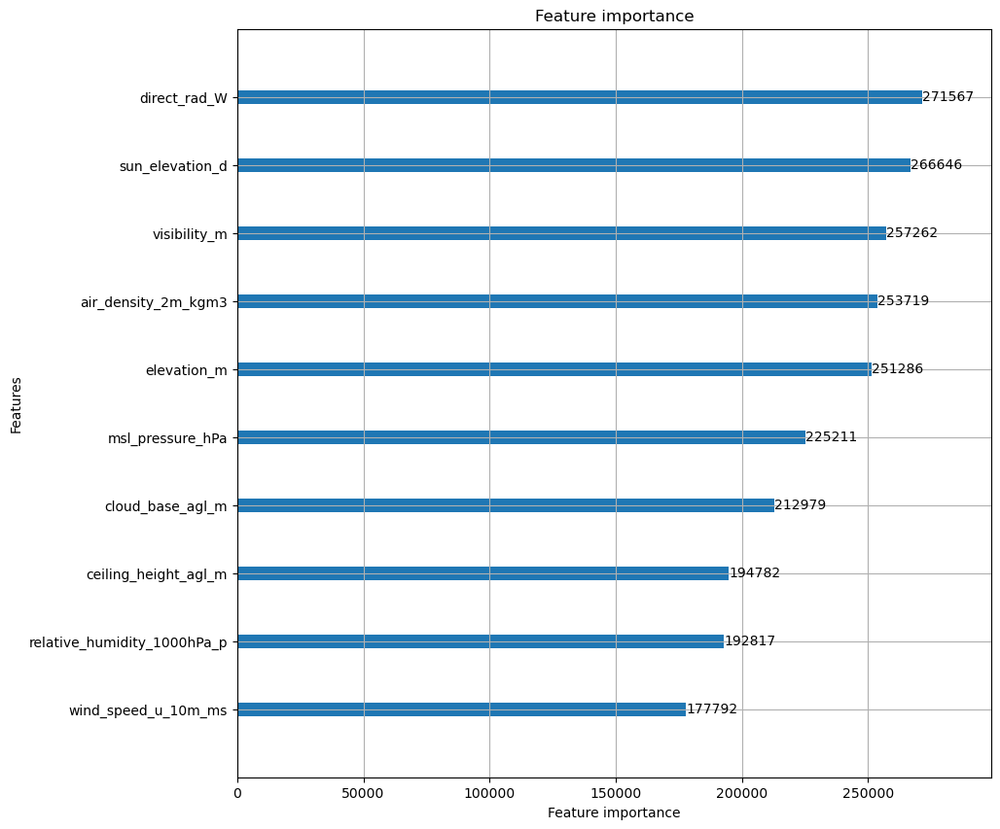

In [11]:
lgb.plot_importance(model, max_num_features=10, figsize=(10,10))

In [28]:
X_test_selected.shape

(8640, 20)

: 

In [12]:
y_hat = model.predict(X_test_selected)

In [26]:
y_hat.shape

(8640,)

In [14]:
# Post-process the predictions to ensure they are >= 0
y_hat_non_negative = np.maximum(y_hat, 0)

In [15]:
y_hat_non_negative

array([ 0.        ,  1.74318236,  0.        , ..., 26.64580257,
        9.11990857, 12.24051748])

In [16]:
y_hat_non_neg_df = ut.create_results_dataframe(X_test, y_hat_non_negative)

<Axes: xlabel='hour'>

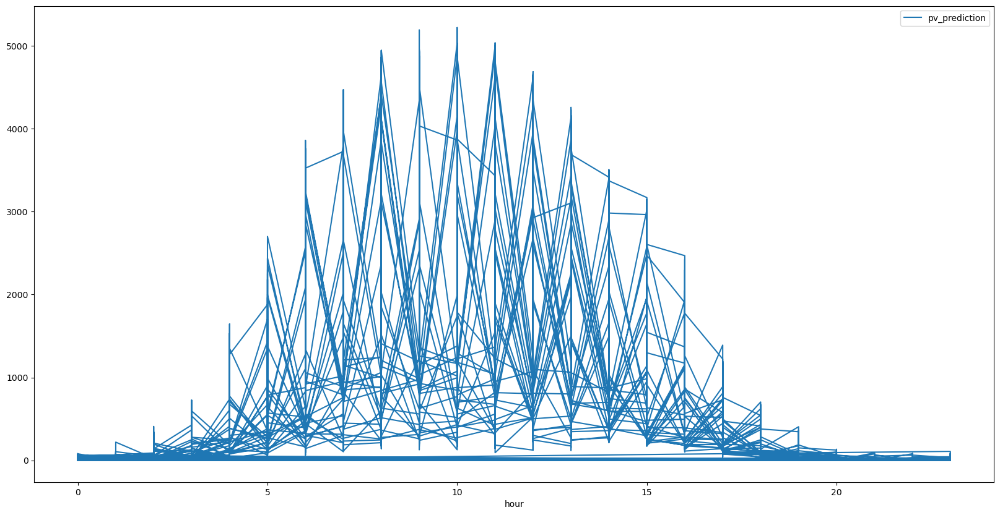

In [24]:
y_hat_non_neg_df.plot('hour', 'pv_prediction', figsize=(20,10))

In [25]:
ut.save_to_csv(y_hat_non_neg_df, 'lightgbmRegressor.csv')